# Behavioral correlates of cortical semantic representations modeled by semantic word vectors

This notbook written by Satoshi Nishida includes the code underlying all figures and tables in our research paper.

## Requirements:

* FreeSurfer (https://surfer.nmr.mgh.harvard.edu/)
* ImageMagick (https://imagemagick.org/)
* The following Python libralies
 * nibabel (https://nipy.org/nibabel/)
 * mayavi (https://mayavi.readthedocs.io/)
 * pysurfer (https://pysurfer.github.io/)

In [1]:
import os
import os.path
import sys

import subprocess
import platform

import numpy as np
import pandas as pd
import h5py
from scipy import stats
from scipy.spatial import distance
import itertools

from mayavi import mlab
import nibabel as nib
from surfer import Brain
import cortex

from statsmodels.stats.multitest import fdrcorrection

from PIL import Image
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.colors import LinearSegmentedColormap
from matplotlib.backends.backend_pdf import PdfPages
import mpl_toolkits.axes_grid1

## General settings

In [2]:
# Output directory
out_dir = "out"
if not os.path.exists(out_dir):
    os.mkdir(out_dir)

# Result data file
data_file = "data.h5"

# Embedding model names
model_names = ["ftsg", "glove", "w2vsg"]
model_full_names = ["fastText", "GloVe", "Word2vec"]
n_models = len(model_names)

ctrl_model_names = [x + "shuf" for x in model_names]
n_ctrl_models = len(ctrl_model_names)

all_model_names = model_names + ["bowbin"]
all_model_full_names = model_full_names + ["Binary-labeling"]
n_all_models = len(all_model_names)

# Vector dimensions
vecsizes = [100, 300, 500, 1000, 2000]
n_vecsizes = len(vecsizes)

# Vector dimension index for main analysis
dim_idx = 3  # Dimension = 1000

# Threshold alpha value for FDR
thresh_alpha = 0.05

# Noun categories
noun_categories = ["Humans", "Non-human animals", "Non-animal natural things", "Constructs", "Vehicles", "Other artifacts"]
n_noun_cats = len(noun_categories)

## Preparation for matplotlib

In [3]:
mpl.use("Agg")
%matplotlib inline

params = {
    "figure.figsize": [6, 6],
    "figure.autolayout": False,
    "font.weight": "normal",
    "font.family": "Arial", # ~/.cache/matplotlib/fontList.json shows available fonts
    "font.size": 18,
    "legend.fontsize": 18,
    "lines.linewidth": .5,
    "axes.linewidth": .5,
    "xtick.major.width": .5,
    "ytick.major.width": .5,
    "pdf.fonttype": 42, # Avoid Type3 fonts
}
mpl.rcParams.update(params)

## Preparation for pysurfer

In [4]:
# For offscreen rendering (comment out if your envioronment needs not)
mlab.options.offscreen = True

pf = platform.system()
if pf == "Darwin":
    subjects_dir = "/Applications/freesurfer/subjects"
elif pf == "Linux":
    subjects_dir = "/usr/local/freesurfer/subjects"
    
subject_id = "fsaverage"
surf = "inflated"

lh_aparc_file = os.path.join(subjects_dir, subject_id, "label", "lh" + ".aparc.a2009s.annot")
rh_aparc_file = os.path.join(subjects_dir, subject_id, "label", "rh" + ".aparc.a2009s.annot")

# Load ROI labels and names
lh_labels, _, lh_names = nib.freesurfer.read_annot(lh_aparc_file)
rh_labels, _, rh_names = nib.freesurfer.read_annot(rh_aparc_file)

n_hemi_rois = len(lh_names)

### Function for original colormap generation

In [5]:
def generate_cmap(colors):
    values = range(len(colors))

    vmax = np.ceil(np.max(values))
    color_list = []
    for v, c in zip(values, colors):
        color_list.append( ( v / vmax, c) )
    return LinearSegmentedColormap.from_list("custom_cmap", color_list)

## Load data

In [6]:
with h5py.File(data_file, "r") as f:
    
    roi_names = f["roi_names"][()]
    n_rois = f["n_rois"][()]
    pyctx_id = f["pyctx_id"][()]
    
    for mov in ["mov1", "mov2"]:
        
        exec(f"{mov}_n_voxels = f['{mov}_n_voxels'][()]")
        exec(f"{mov}_roi_n_voxels = f['{mov}_roi_n_voxels'][()]")
        
        exec(f"{mov}_acc = f['{mov}_acc'][()]")
        exec(f"{mov}_fracsig = f['{mov}_fracsig'][()]")
        exec(f"{mov}_roi_acc = f['{mov}_roi_acc'][()]")
        exec(f"{mov}_roi_fracsig = f['{mov}_roi_fracsig'][()]")
        exec(f"{mov}_roi_ctrl_fracsig = f['{mov}_roi_ctrl_fracsig'][()]")
        exec(f"{mov}_maxacc = f['{mov}_maxacc'][()]")
        exec(f"{mov}_subj_acc_epi = f['{mov}_subj_acc_epi'][()]")
        
    mri_subj_names = f["mri_subj_names"][()]
    n_sel_voxels = f["n_sel_voxels"][()]
    n_n_sel_voxels = f["n_n_sel_voxels"][()]
    n_overlap = f["n_overlap"][()]
    overlap_vecsize = f["overlap_vecsize"][()]
    n_perm_itrs = f["n_perm_itrs"][()]
    
    for pos in ["noun", "adj"]:
        exec(f"behav_{pos}_dissim = f['behav_{pos}_dissim'][()]")
        exec(f"{pos}s = f['{pos}s'][()]")
        exec(f"{pos}_n_trials = f['{pos}_n_trials'][()]")
        exec(f"n_{pos}s = f['n_{pos}s'][()]")
        exec(f"n_{pos}_pairs = f['n_{pos}_pairs'][()]")
        
        exec(f"wv_{pos}_dissim = f['wv_{pos}_dissim'][()]")
        exec(f"wv_{pos}_corr_perm_samps = f['wv_{pos}_corr_perm_samps'][()]")
        
        exec(f"overlap_brain_{pos}_dissim = f['overlap_brain_{pos}_dissim'][()]")
        exec(f"overlap_{pos}_corr_perm_samps = f['overlap_{pos}_corr_perm_samps'][()]")
        exec(f"overlap_{pos}_indiv_corr_perm_samps = f['overlap_{pos}_indiv_corr_perm_samps'][()]")
        
        for mov in ["mov1", "mov2"]:
            exec(f"{mov}_{pos}_dissim = f['{mov}_{pos}_dissim'][()]")
            exec(f"{mov}_{pos}_dissim_selvox = f['{mov}_{pos}_dissim_selvox'][()]")
            exec(f"{mov}_{pos}_corr_perm_samps = f['{mov}_{pos}_corr_perm_samps'][()]")
            exec(f"{mov}_{pos}_corr_perm_samps_selvox = f['{mov}_{pos}_corr_perm_samps_selvox'][()]")
            exec(f"{mov}_roi_{pos}_dissim = f[f'{mov}_roi_{pos}_dissim'][()]")
            
    for mov in ["mov1", "mov2"]:
        exec(f"cat_{mov}_corr = f['cat_{mov}_corr'][()]")
        exec(f"cat_{mov}_corr_perm_samps = f['cat_{mov}_corr_perm_samps'][()]")
        
    bow_vecsizes = f["bow_vecsizes"][()]
    n_bow_vecsizes = f["n_bow_vecsizes"][()]
    bow_corr = f["bow_corr"][()]
    bow_corr_perm_samps = f["bow_corr_perm_samps"][()]

## Match the index of ROIs

In [7]:
roi_names = np.array([x.decode() for x in roi_names])
n_roi_names = len(roi_names)

roi_idx = np.zeros((2, n_hemi_rois), dtype=int) - 1  # default = -1

for i, name in enumerate(lh_names):
    mask = roi_names == "ctx_lh_" + name.decode()
    if np.any(mask):
        roi_idx[0, i] = np.where(mask)[0][0]

for i, name in enumerate(rh_names):
    mask = roi_names == "ctx_rh_" + name.decode()
    if np.any(mask):
        roi_idx[1, i] = np.where(mask)[0][0]

## Fig. 1: An example of brain model-drived word dissimilarity matrix

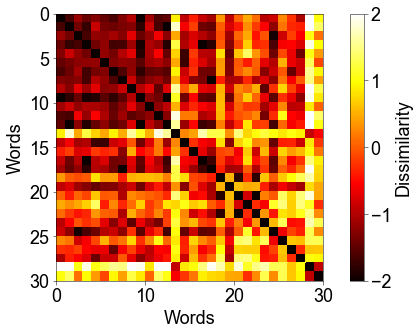

In [8]:
ex_dissim = mov1_adj_dissim[0, dim_idx]

n_words = 30
max_val = 2
min_val = -2

fig = plt.figure(figsize=(8, 5))

ax = plt.subplot(1, 1, 1)

mat = distance.squareform(ex_dissim)[:n_words, :n_words]
mat[np.diag_indices_from(mat)] = min_val
m = ax.pcolor(mat, cmap="hot", vmax=max_val, vmin=min_val)
ax.axis("square")

ax.set_xlabel("Words")
ax.invert_yaxis()
ax.set_ylabel("Words")

# Colorbar
cbar = fig.colorbar(m, ax=ax)
cbar.set_label("Dissimilarity")

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'exam_dissim_mat_brain.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. 2: An example of behavior-derived word dissimilarity matrix

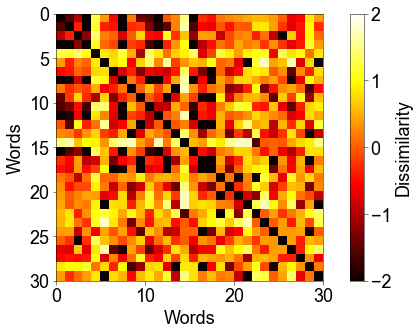

In [9]:
ex_dissim = stats.zscore(behav_adj_dissim.mean(axis=0))

n_words = 30
max_val = 2
min_val = -2

fig = plt.figure(figsize=(8, 5))

ax = plt.subplot(1, 1, 1)

mat = distance.squareform(ex_dissim)[:n_words, :n_words]
mat[np.diag_indices_from(mat)] = min_val
m = ax.pcolor(mat, cmap="hot", vmax=max_val, vmin=min_val)
ax.axis("square")

ax.set_xlabel("Words")
ax.invert_yaxis()
ax.set_ylabel("Words")

# Colorbar
cbar = fig.colorbar(m, ax=ax)
cbar.set_label("Dissimilarity")

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'exam_dissim_mat_behav.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. 3: Histogram of model accuracy

Pred acc, fastText, Movie set 1: mean = 0.09277376875813519
Frac sig, fastText, Movie set 1: mean = 0.5746972887913121
Pred acc, fastText, Movie set 2: mean = 0.08648330487310887
Frac sig, fastText, Movie set 2: mean = 0.5260665573387137
Pred acc, GloVe, Movie set 1: mean = 0.0955189225663032
Frac sig, GloVe, Movie set 1: mean = 0.5892328558345605
Pred acc, GloVe, Movie set 2: mean = 0.08836783973500133
Frac sig, GloVe, Movie set 2: mean = 0.540556780836688
Pred acc, Word2vec, Movie set 1: mean = 0.09665344671479294
Frac sig, Word2vec, Movie set 1: mean = 0.5935942214382387
Pred acc, Word2vec, Movie set 2: mean = 0.08912585880607367
Frac sig, Word2vec, Movie set 2: mean = 0.5428297567509517


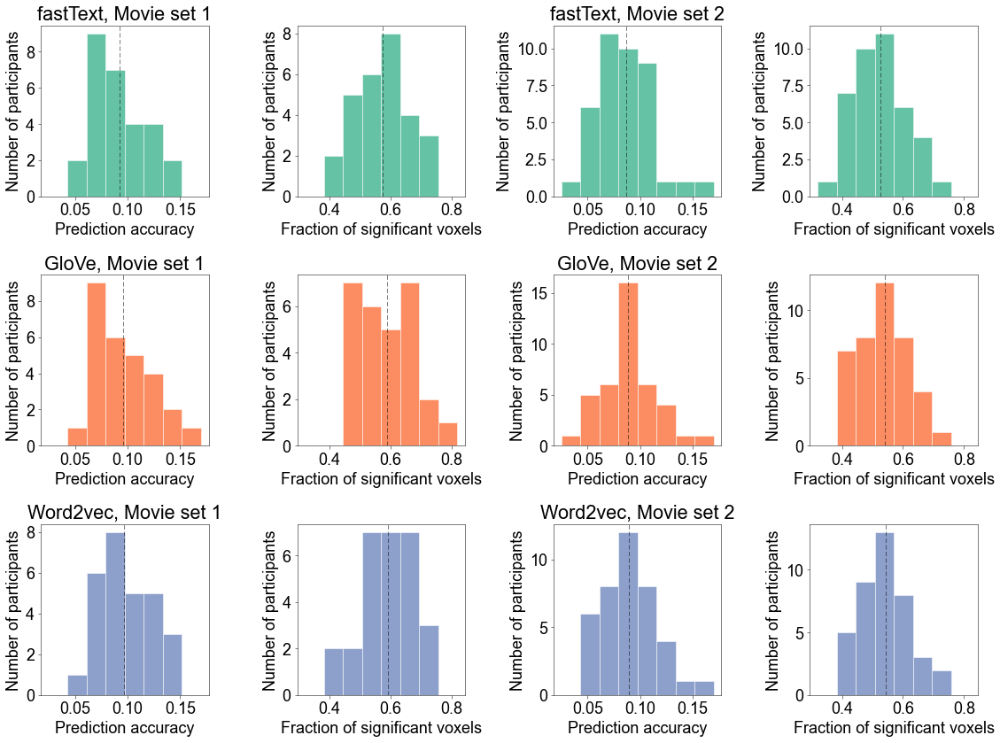

In [10]:
acc_range = [.025, .17]
fracsig_range = [.32, .82]
n_bins = 8
cols = mpl.cm.Set2(range(3))

fig = plt.figure(figsize=(16, 12))

for mi, model in enumerate(model_full_names):
    for movi, mov in enumerate(["mov1", "mov2"]):

        ax = plt.subplot(3, 4, mi * 4 + movi * 2 + 1)

        ax.hist(eval(f"{mov}_acc")[mi, dim_idx], bins=n_bins, range=acc_range, ec="w", fc=cols[mi], lw=.5)
        
        mean_val = eval(f"{mov}_acc")[mi, dim_idx].mean()
        ax.axvline(mean_val, ls="--", dashes=(10, 5), c="k")

        ax.set_xlabel("Prediction accuracy")
        ax.set_ylabel("Number of participants")
        ax.set_title(f"{model}, Movie set {movi + 1}")

        print(f"Pred acc, {model}, Movie set {movi + 1}: mean = {mean_val}")

        ##

        ax = plt.subplot(3, 4, mi * 4 + movi * 2 + 2)

        ax.hist(eval(f"{mov}_fracsig")[mi, dim_idx], bins=n_bins, range=fracsig_range, ec="w", fc=cols[mi], lw=.5)
        
        mean_val = eval(f"{mov}_fracsig")[mi, dim_idx].mean()
        ax.axvline(mean_val, ls="--", dashes=(10, 5), c="k")

        ax.set_xlabel("Fraction of significant voxels")
        ax.set_ylabel("Number of participants")

        print(f"Frac sig, {model}, Movie set {movi + 1}: mean = {mean_val}")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'model_acc.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

### Comparisons of accuracy between models

In [11]:
pairs = list(itertools.combinations(range(n_models), 2))
n_pairs = len(pairs)

pvals = np.ones((4, n_pairs))

for i, ps in enumerate(pairs):
    pvals[0, i] = stats.wilcoxon(mov1_acc[ps[0]][dim_idx], mov1_acc[ps[1]][dim_idx])[1]
    pvals[1, i] = stats.wilcoxon(mov1_fracsig[ps[0]][dim_idx], mov1_fracsig[ps[1]][dim_idx])[1]
    pvals[2, i] = stats.wilcoxon(mov2_acc[ps[0]][dim_idx], mov2_acc[ps[1]][dim_idx])[1]
    pvals[3, i] = stats.wilcoxon(mov2_fracsig[ps[0]][dim_idx], mov2_fracsig[ps[1]][dim_idx])[1]
    
corr_pvals = [fdrcorrection(ps, alpha=thresh_alpha)[1] for ps in pvals]
    
for i, ps in enumerate(pairs):
    print("{} vs. {}".format(model_full_names[ps[0]], model_full_names[ps[1]]))
    
    print("Mov 1, Pred acc: p = {}".format(corr_pvals[0][i]))
    print("Mov 2, Frac sig: p = {}".format(corr_pvals[1][i]))
    print("Mov 1, Pred acc: p = {}".format(corr_pvals[2][i]))
    print("Mov 2, Frac sig: p = {}".format(corr_pvals[3][i]))

fastText vs. GloVe
Mov 1, Pred acc: p = 4.185388241301636e-05
Mov 2, Frac sig: p = 1.0887422271551008e-05
Mov 1, Pred acc: p = 5.525411795908841e-05
Mov 2, Frac sig: p = 2.753938125645674e-07
fastText vs. Word2vec
Mov 1, Pred acc: p = 1.1368858324742614e-05
Mov 2, Frac sig: p = 1.0887422271551008e-05
Mov 1, Pred acc: p = 2.1141984395211658e-07
Mov 2, Frac sig: p = 1.07081646133981e-07
GloVe vs. Word2vec
Mov 1, Pred acc: p = 0.03231326680260798
Mov 2, Frac sig: p = 0.06186574638446707
Mov 1, Pred acc: p = 0.01934652552640764
Mov 2, Frac sig: p = 0.15037197919132064


### Monotonicity test

In [12]:
mov1_n_subjs = mov1_acc[0].shape[1]
mov2_n_subjs = mov2_acc[0].shape[1]

for movi, mov in enumerate(["mov1", "mov2"]):
    exec(mov + "_x = np.tile(list(range(0, n_vecsizes)), (" + mov + "_n_subjs, 1)).T.ravel()")

print("Prediction accuracy")
for mi, model in enumerate(model_full_names):
    print(" " + model)
    for movi, mov in enumerate(["mov1", "mov2"]):
        tau, p = stats.kendalltau(eval(mov + "_x"), eval(mov + "_acc[mi].ravel()"))
        print("  {}: tau = {}, p = {}".format(mov, tau, p))
        
print("Fraction of significant voxels")
for mi, model in enumerate(model_full_names):
    print(" " + model)
    for movi, mov in enumerate(["mov1", "mov2"]):
        tau, p = stats.kendalltau(eval(mov + "_x"), eval(mov + "_fracsig[mi].ravel()"))
        print("  {}: tau = {}, p = {}".format(mov, tau, p))

Prediction accuracy
 fastText
  mov1: tau = -0.007098674097415194, p = 0.909164890853754
  mov2: tau = 0.05447280451895977, p = 0.2942020478006564
 GloVe
  mov1: tau = 0.005953726662348228, p = 0.9237667547147864
  mov2: tau = 0.05447280451895977, p = 0.2942020478006564
 Word2vec
  mov1: tau = 0.010533516402616095, p = 0.8655624409769552
  mov2: tau = 0.05503322431853754, p = 0.28926305677655095
Fraction of significant voxels
 fastText
  mov1: tau = -0.044194970993584916, p = 0.4775091313369685
  mov2: tau = 0.03945355389027539, p = 0.447414861815586
 GloVe
  mov1: tau = -0.026104801519526846, p = 0.6748039890206841
  mov2: tau = 0.0618703458733864, p = 0.23349748030114037
 Word2vec
  mov1: tau = -0.021296022292245583, p = 0.7321432720441534
  mov2: tau = 0.07083706266663081, p = 0.1725473994315908


## Fig. S1: Accuracy for all vector dimensions for fastText

Change from min to max
  Mean prediction accuracy: 13%
  Mean fraction of significant voxels: 14.7%


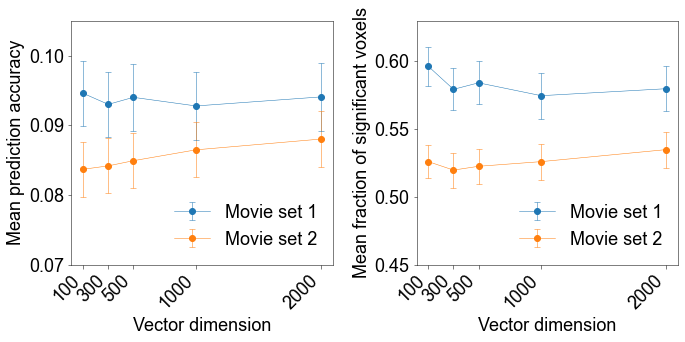

In [13]:
model_idx = 0

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = np.vstack([mov1_acc[model_idx].mean(axis=1), mov2_acc[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_acc[model_idx].shape[1]), mov2_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_acc[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.07, 0.105])
ax.set_ylabel("Mean prediction accuracy")

print("Change from min to max")
print("  Mean prediction accuracy: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = np.vstack([mov1_fracsig[model_idx].mean(axis=1), mov2_fracsig[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_fracsig[model_idx].shape[1]), mov2_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_fracsig[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.45, 0.63])
ax.set_ylabel("Mean fraction of significant voxels")

print("  Mean fraction of significant voxels: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "model_acc_all_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Comparison across vector dimensions for fastText

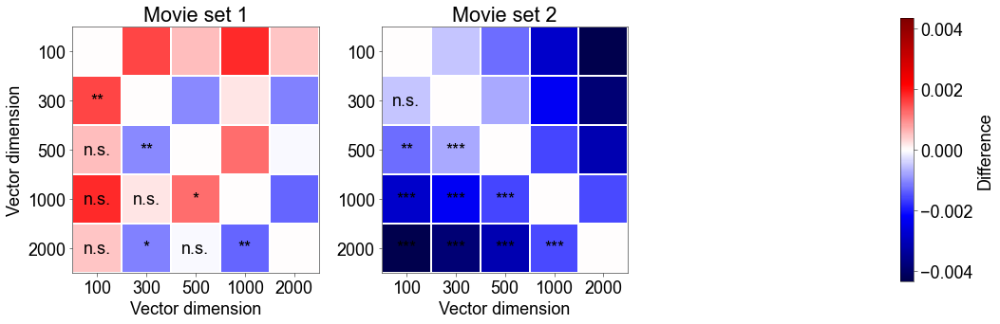

In [14]:
model_idx = 0

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_acc", "mov2_acc"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "pred_acc_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

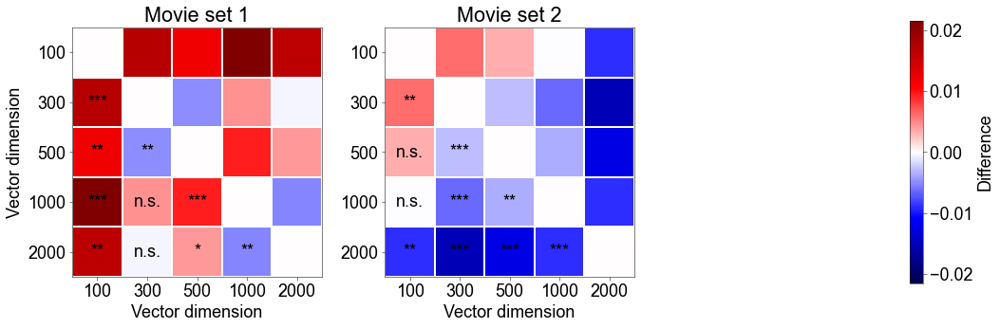

In [15]:
model_idx = 0

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_fracsig", "mov2_fracsig"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

m = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(m, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "frac_sig_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Fig. S2: Accuracy for all vector dimensions for GloVe

Change from min to max
  Mean prediction accuracy: 12.8%
  Mean fraction of significant voxels: 12.4%


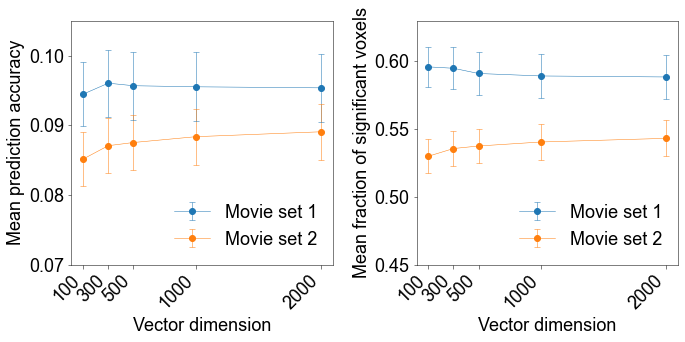

In [16]:
model_idx = 1

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = np.vstack([mov1_acc[model_idx].mean(axis=1), mov2_acc[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_acc[model_idx].shape[1]), mov2_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_acc[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.07, 0.105])
ax.set_ylabel("Mean prediction accuracy")

print("Change from min to max")
print("  Mean prediction accuracy: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = np.vstack([mov1_fracsig[model_idx].mean(axis=1), mov2_fracsig[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_fracsig[model_idx].shape[1]), mov2_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_fracsig[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.45, 0.63])
ax.set_ylabel("Mean fraction of significant voxels")

print("  Mean fraction of significant voxels: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "model_acc_all_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Comparison across vector dimensions for GloVe

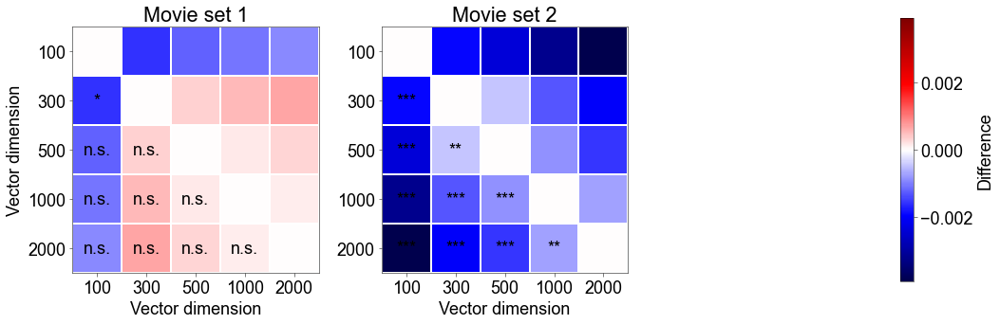

In [17]:
model_idx = 1

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_acc", "mov2_acc"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "pred_acc_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

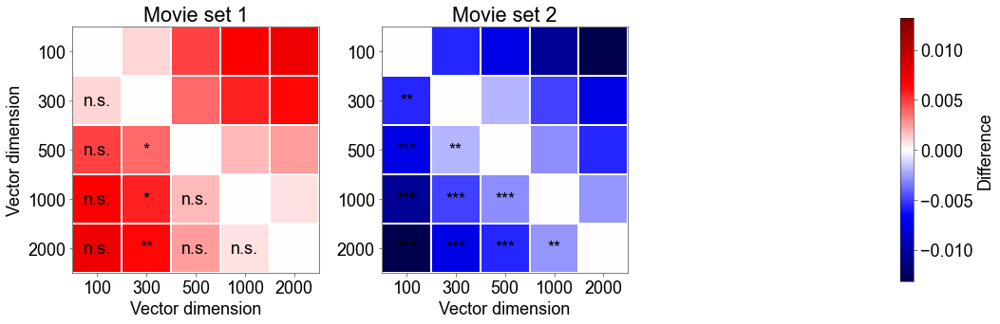

In [18]:
model_idx = 1

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_fracsig", "mov2_fracsig"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

m = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(m, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "frac_sig_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Fig. S3: Accuracy for all vector dimensions for word2vec

Change from min to max
  Mean prediction accuracy: 13.2%
  Mean fraction of significant voxels: 13%


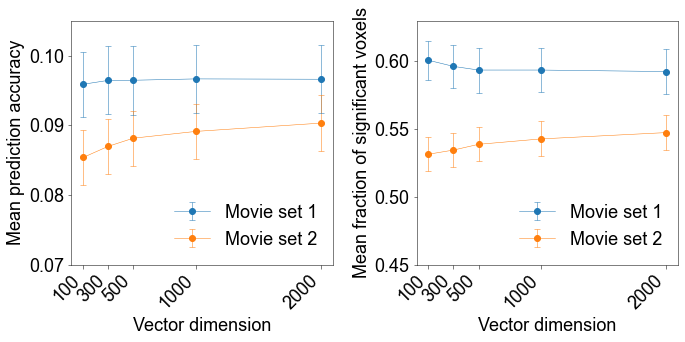

In [19]:
model_idx = 2

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = np.vstack([mov1_acc[model_idx].mean(axis=1), mov2_acc[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_acc[model_idx].shape[1]), mov2_acc[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_acc[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.07, 0.105])
ax.set_ylabel("Mean prediction accuracy")

print("Change from min to max")
print("  Mean prediction accuracy: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = np.vstack([mov1_fracsig[model_idx].mean(axis=1), mov2_fracsig[model_idx].mean(axis=1)]).T
e = np.vstack([mov1_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov1_fracsig[model_idx].shape[1]), mov2_fracsig[model_idx].std(axis=1, ddof=1) / np.sqrt(mov2_fracsig[model_idx].shape[1])]).T
for i in range(2):
    ax.errorbar(x, y[:, i], yerr=e[:, i], marker="o", c=mpl.cm.tab10(i), lw=.5, capthick=.5, capsize=3)

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([0.45, 0.63])
ax.set_ylabel("Mean fraction of significant voxels")

print("  Mean fraction of significant voxels: {:.3g}%".format((y.max() - y.min()) / y.min() * 100))

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "model_acc_all_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Comparison across vector dimensions for word2vec

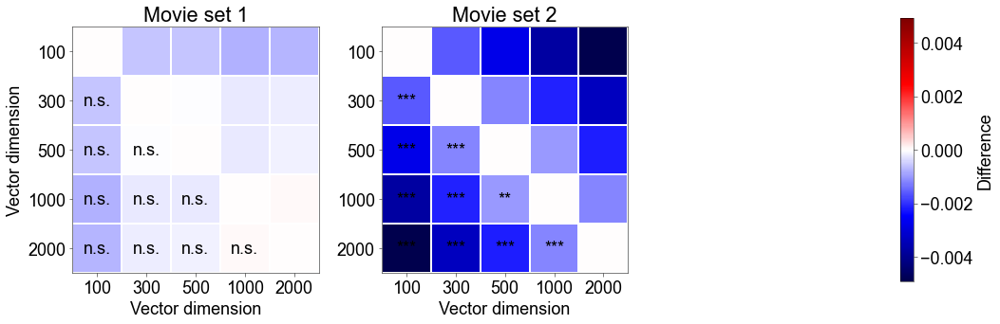

In [20]:
model_idx = 2

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_acc", "mov2_acc"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "pred_acc_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

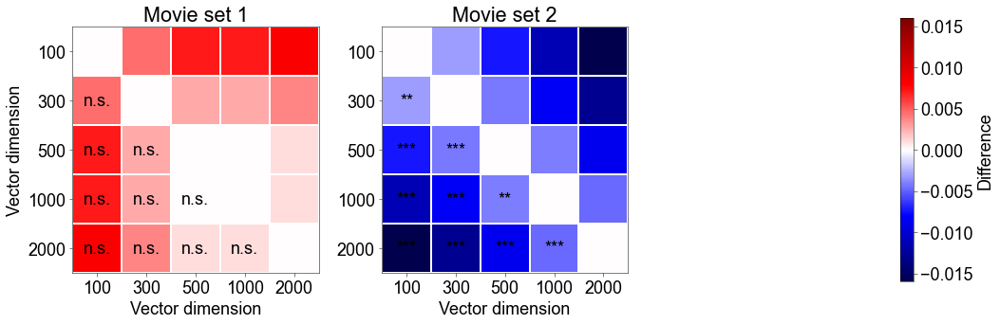

In [21]:
model_idx = 2

pairs = list(itertools.combinations(range(n_vecsizes), 2))
var_names = ["mov1_fracsig", "mov2_fracsig"]

diff_vals = []
corr_pvals = []
for i, name in enumerate(var_names):
    diff_vals.append([eval(name)[model_idx][x[0]].mean() - eval(name)[model_idx][x[1]].mean() for x in pairs])
    pvals = [stats.wilcoxon(eval(name)[model_idx][x[0]], eval(name)[model_idx][x[1]])[1] for x in pairs]
    corr_pvals.append(fdrcorrection(pvals, alpha=thresh_alpha)[1])

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

m = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(m, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "frac_sig_cmpr_{}.pdf".format(model_names[model_idx])))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Fig S4: Accuracy of binary-labeling model

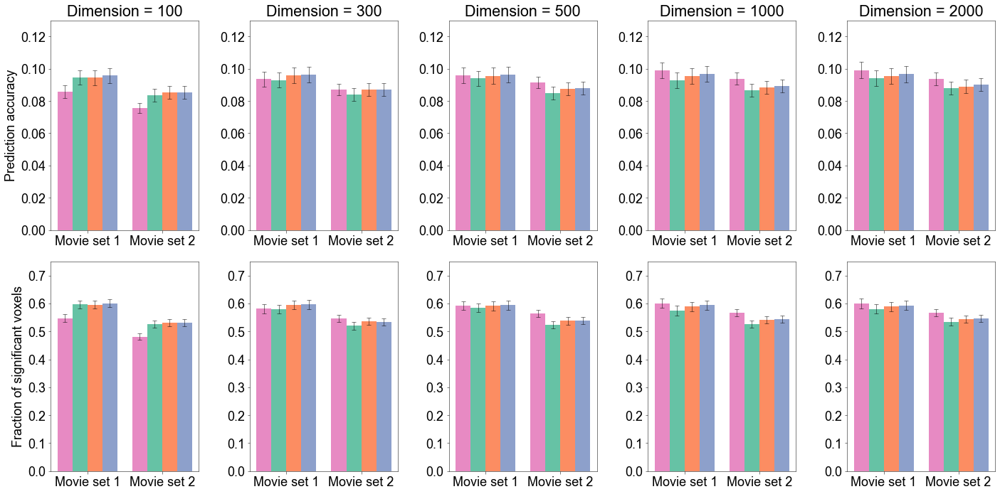

In [22]:
x = np.arange(2)
width = 0.2
y_max = [0.13, 0.75]

cols = mpl.cm.Set2([3, 0, 1, 2])

fig = plt.figure(figsize=[20, 10])

for si, size in enumerate(vecsizes):

    ax = plt.subplot(2, n_vecsizes, si + 1)

    for movi, mov in enumerate(["mov1", "mov2"]):
        for i, mi in enumerate([3, 0, 1, 2]):
            val = eval(mov + "_acc")[mi, si]
            y = val.mean()
            e = val.std(ddof=1) / np.sqrt(len(val))
            ax.bar(x[movi] + width * (i - 1.5), y, yerr=e, width=width, fc=cols[i], error_kw=dict(lw=.5, capthick=.5, capsize=3))

    ax.set_xticks(x)
    ax.set_xticklabels(["Movie set 1", "Movie set 2"])
    ax.set_ylim([0, y_max[0]])
    if si == 0:
        ax.set_ylabel("Prediction accuracy")
    ax.set_title("Dimension = {}".format(size))
    
    ##
    
    ax = plt.subplot(2, n_vecsizes, si + n_vecsizes + 1)

    for movi, mov in enumerate(["mov1", "mov2"]):
        for i, mi in enumerate([3, 0, 1, 2]):
            val = eval(mov + "_fracsig")[mi, si]
            y = val.mean()
            e = val.std(ddof=1) / np.sqrt(len(val))
            ax.bar(x[movi] + width * (i - 1.5), y, yerr=e, width=width, fc=cols[i], error_kw=dict(lw=.5, capthick=.5, capsize=3))

    ax.set_xticks(x)
    ax.set_xticklabels(["Movie set 1", "Movie set 2"])
    ax.set_ylim([0, y_max[1]])
    if si == 0:
        ax.set_ylabel("Fraction of significant voxels")

fig.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "model_acc_bow.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Difference between binary-labeling and other models

In [23]:
# Statistical test
p_acc = np.ones((n_vecsizes, 2, n_models))
p_fracsig = np.ones((n_vecsizes, 2, n_models))

for si in range(n_vecsizes):
    for movi, mov in enumerate(["mov1", "mov2"]):
        x_acc = eval(mov + "_acc")[3, si]
        x_fracsig = eval(mov + "_fracsig")[3, si]
        
        for mi in range(n_models):
            y_acc = eval(mov + "_acc")[mi, si]
            p_acc[si, movi, mi] = stats.wilcoxon(x_acc, y_acc)[1]
            
            y_fracsig = eval(mov + "_fracsig")[mi, si]
            p_fracsig[si, movi, mi] = stats.wilcoxon(x_fracsig, y_fracsig)[1]

corr_p_acc = fdrcorrection(p_acc.ravel(), alpha=thresh_alpha)[1].reshape(p_acc.shape)
corr_p_fracsig = fdrcorrection(p_fracsig.ravel(), alpha=thresh_alpha)[1].reshape(p_fracsig.shape)
            
# Output
print("Prediction accuracy")
for si, size in enumerate(vecsizes):
    print(" Dimension = {}".format(size))
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print("  " + mov)
        
        vals = eval(mov + "_acc")[:, si]
        print("   BL: mean = {}".format(vals[3].mean()))
        
        for mi, model in enumerate(model_full_names):
            print("   {}: mean = {}, p = {}".format(model, vals[mi].mean(), corr_p_acc[si, movi, mi]))

print("")

print("Fraction of significant voxels")
for si, size in enumerate(vecsizes):
    print(" Dimension = {}".format(size))
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print("  " + mov)
        
        vals = eval(mov + "_fracsig")[:, si]
        print("   BL: mean = {}".format(vals[3].mean()))
        
        for mi, model in enumerate(model_full_names):
            print("   {}: mean = {}, p = {}".format(model, vals[mi].mean(), corr_p_fracsig[si, movi, mi]))

Prediction accuracy
 Dimension = 100
  mov1
   BL: mean = 0.08572248848421234
   fastText: mean = 0.09458100199699403, p = 0.00010820847516858157
   GloVe: mean = 0.09447055248809713, p = 4.35958106844066e-05
   Word2vec: mean = 0.09588495559458221, p = 4.35958106844066e-05
  mov2
   BL: mean = 0.07560186563059687
   fastText: mean = 0.08369712371379137, p = 4.35958106844066e-05
   GloVe: mean = 0.08516908057965338, p = 1.0885965733206698e-05
   Word2vec: mean = 0.08539494944736362, p = 1.0885965733206698e-05
 Dimension = 300
  mov1
   BL: mean = 0.09352863367114748
   fastText: mean = 0.09299872570804184, p = 0.7485767862637233
   GloVe: mean = 0.0960399705384459, p = 0.01597839879258245
   Word2vec: mean = 0.09644127945814811, p = 0.010521640330560023
  mov2
   BL: mean = 0.08713235920295119
   fastText: mean = 0.08418374432250857, p = 0.007448996853071929
   GloVe: mean = 0.08707644840702414, p = 0.9348760032978172
   Word2vec: mean = 0.0869874009490013, p = 0.9464173212856073
 Dime

## Figs. 4, S5-7, S14, and Table 1, S1-3, S13: Cortical mapping of model accuracy

### Model accuracy

In [24]:
p = 0.0001
n_samps = 1200
df = n_samps - 2

t_a = stats.t.ppf(1 - (p / 2), df)
print("Threshold at P = {}: r = {}".format(p, t_a / np.sqrt(df + t_a ** 2)))

Threshold at P = 0.0001: r = 0.11207451016124848


### Minimum and maximum values of colormaps

In [25]:
min_val = 0.11
max_val = np.max([np.max([x.mean(axis=2).max() for x in mov1_roi_acc]),
                  np.max([x.mean(axis=2).max() for x in mov2_roi_acc])])

### fastText

Dimension = 100
mov1


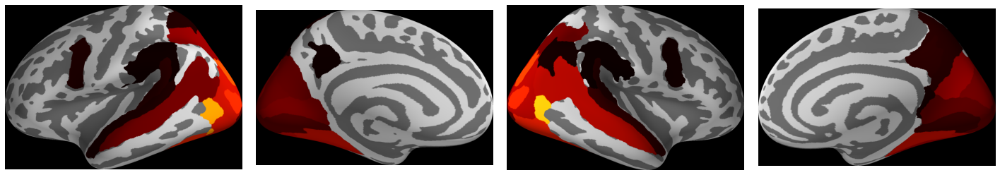

mov2


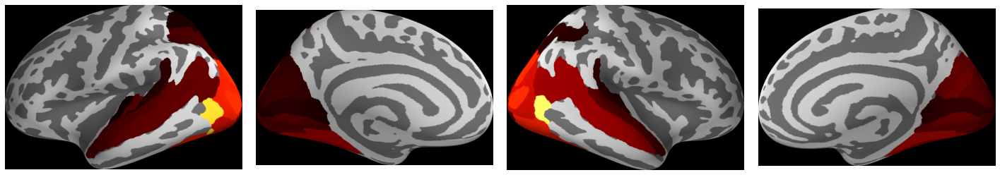

Dimension = 300
mov1


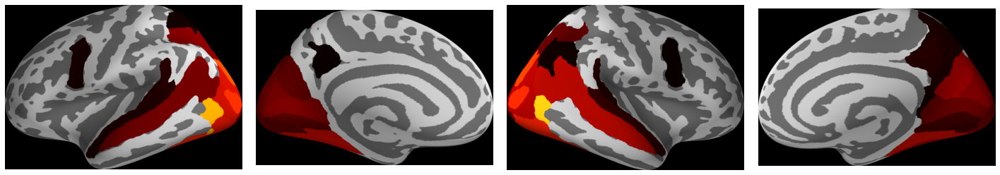

mov2


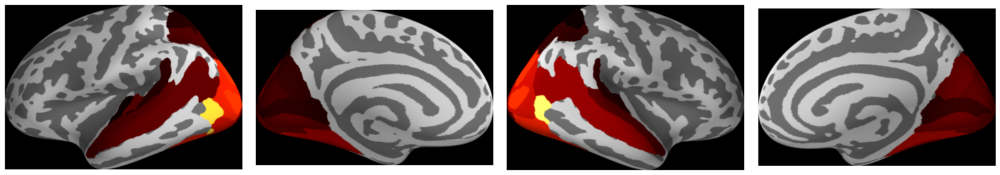

Dimension = 500
mov1


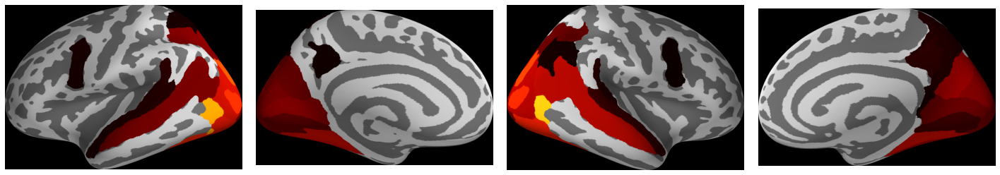

mov2


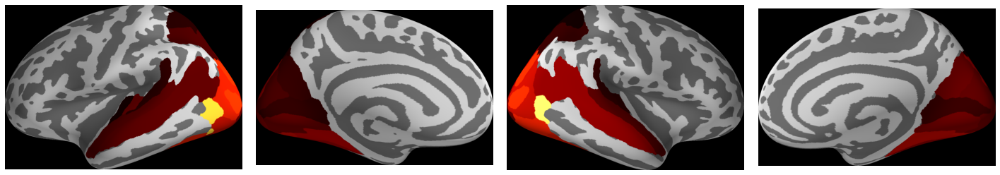

Dimension = 1000
mov1


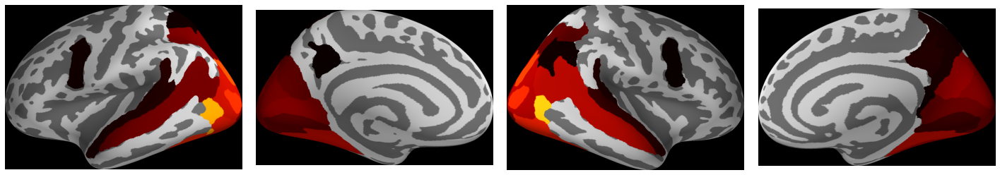

mov2


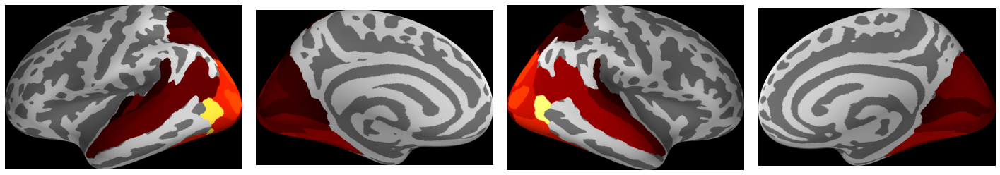

Dimension = 2000
mov1


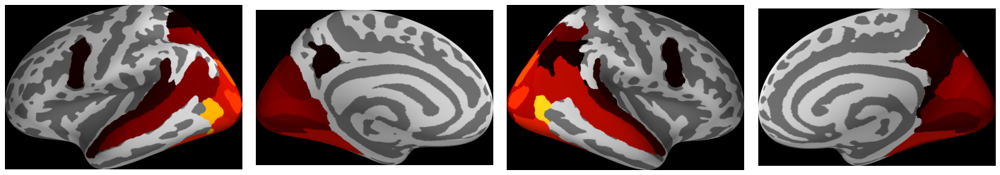

mov2


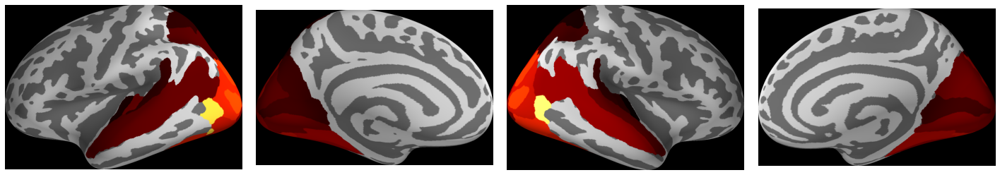

In [26]:
model_idx = 0

out_prefix = os.path.join(out_dir, "pred_acc_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_acc")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### GloVe

Dimension = 100
mov1


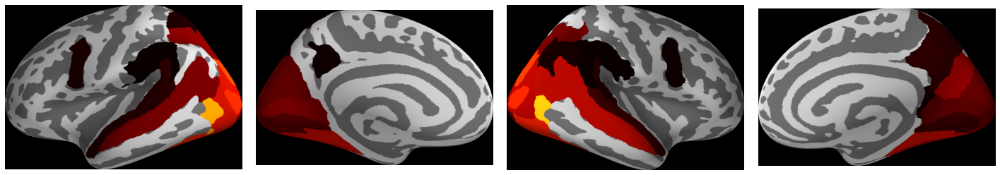

mov2


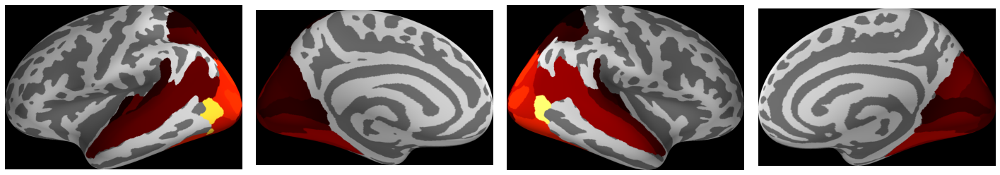

Dimension = 300
mov1


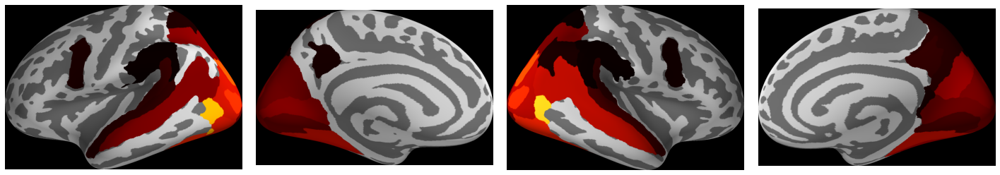

mov2


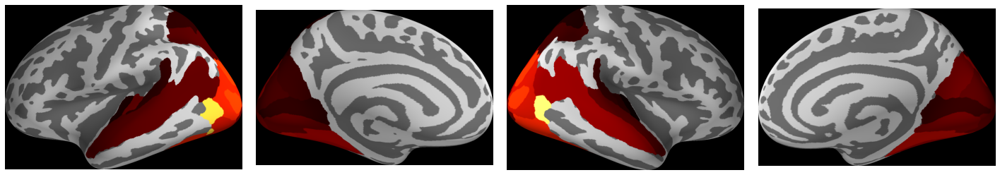

Dimension = 500
mov1


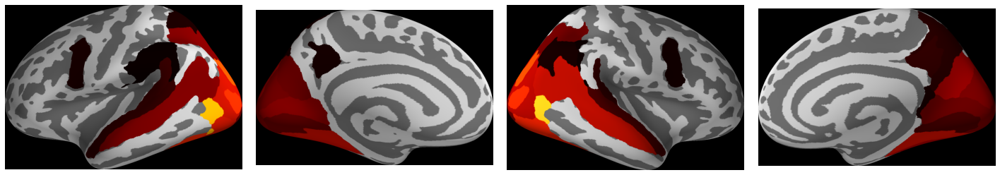

mov2


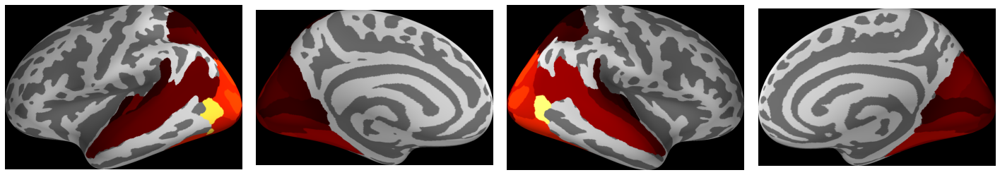

Dimension = 1000
mov1


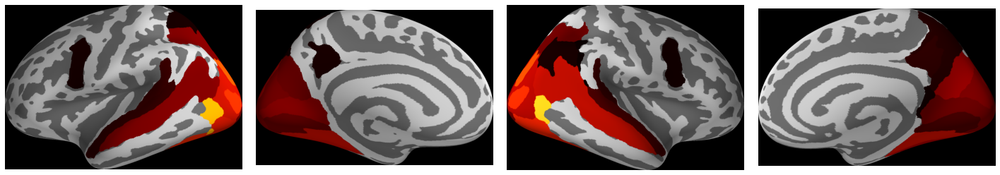

mov2


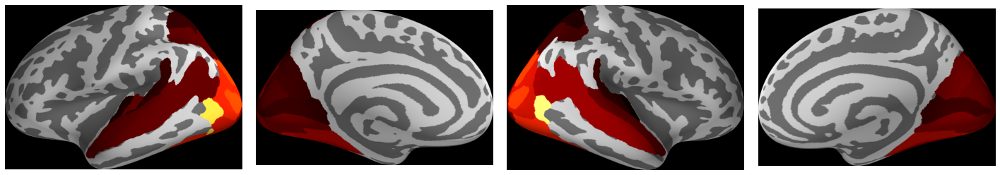

Dimension = 2000
mov1


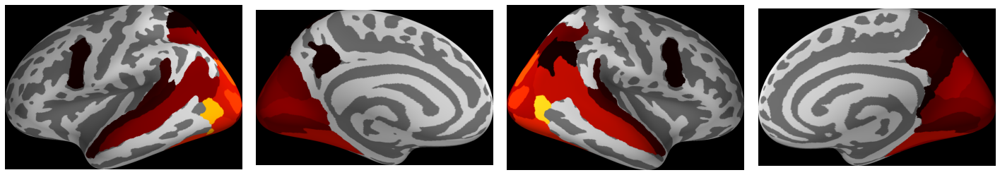

mov2


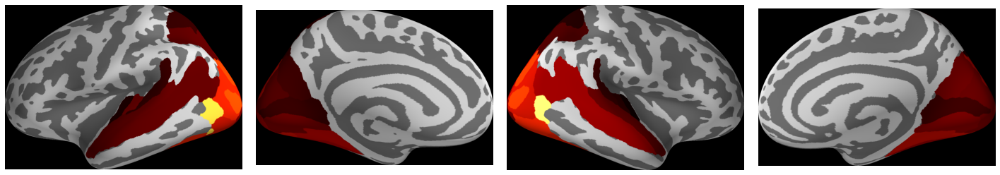

In [27]:
model_idx = 1

out_prefix = os.path.join(out_dir, "pred_acc_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_acc")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Word2vec

Dimension = 100
mov1


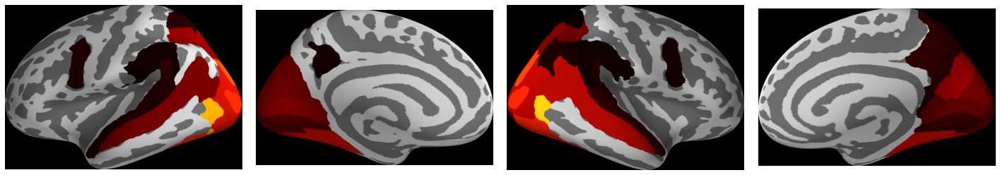

mov2


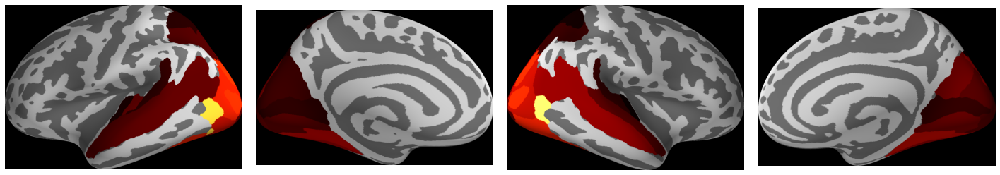

Dimension = 300
mov1


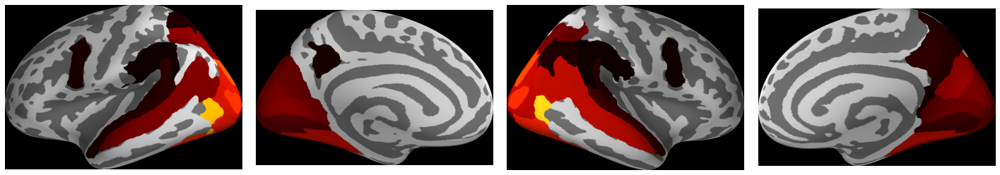

mov2


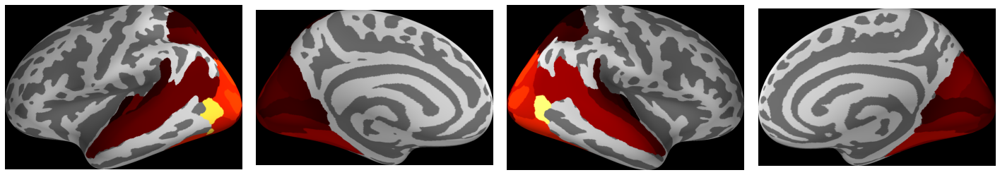

Dimension = 500
mov1


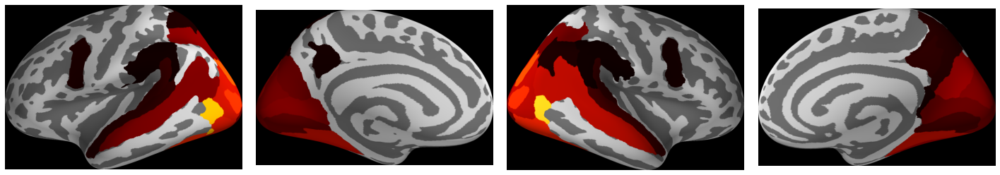

mov2


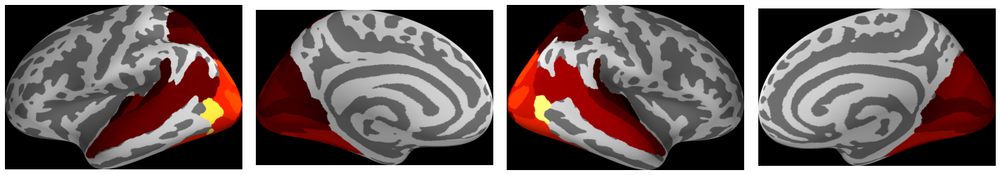

Dimension = 1000
mov1


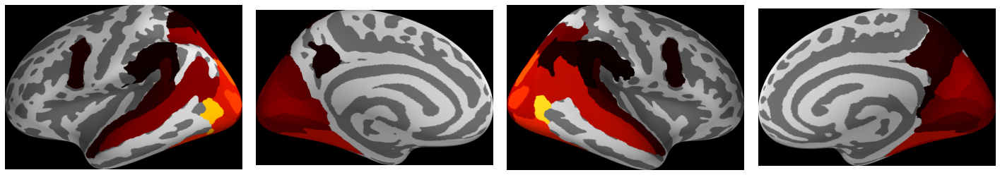

mov2


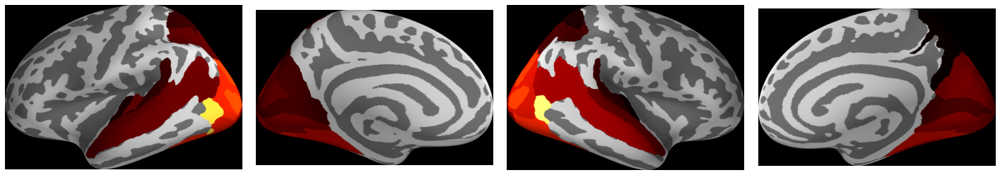

Dimension = 2000
mov1


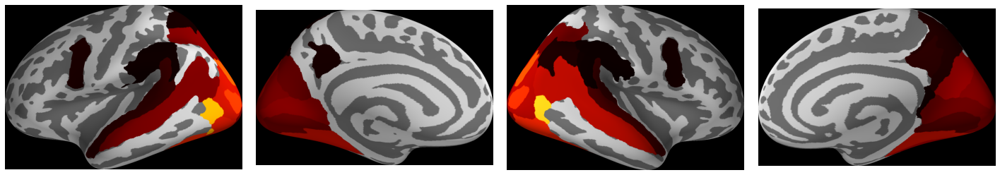

mov2


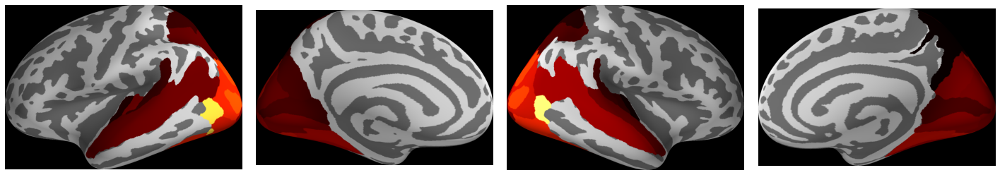

In [29]:
model_idx = 2

out_prefix = os.path.join(out_dir, "pred_acc_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_acc")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Binary-labeling

Dimension = 100
mov1


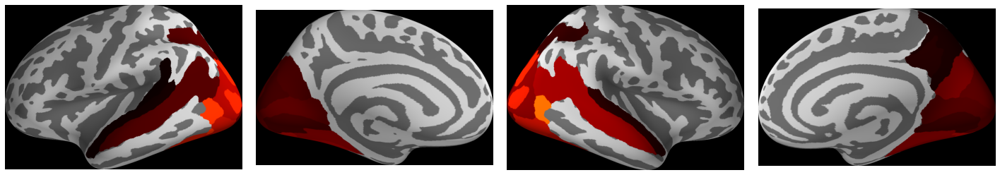

mov2


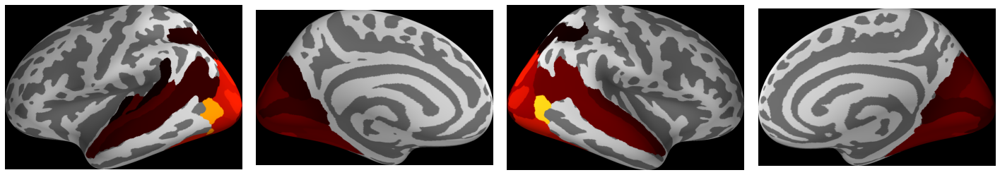

Dimension = 300
mov1


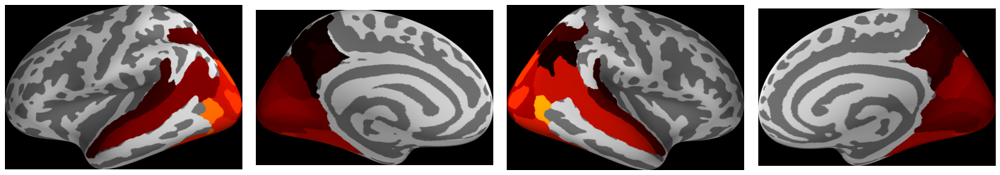

mov2


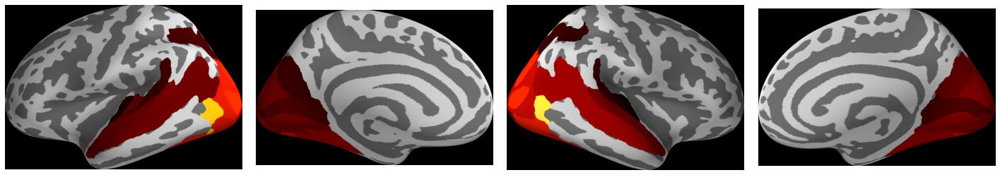

Dimension = 500
mov1


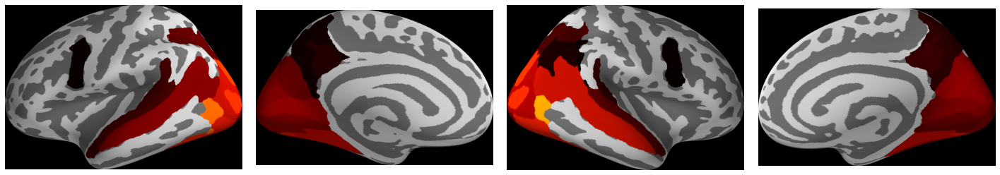

mov2


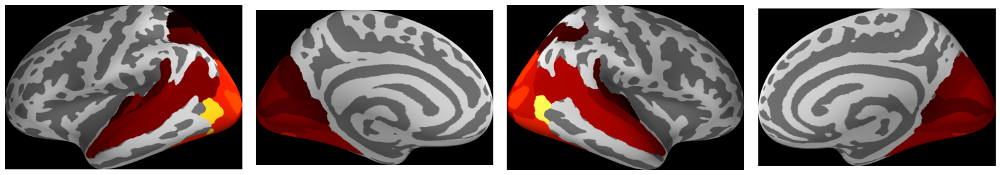

Dimension = 1000
mov1


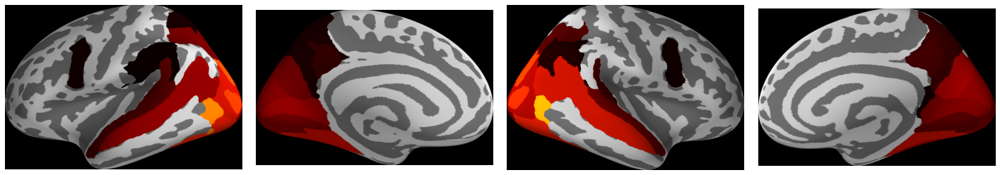

mov2


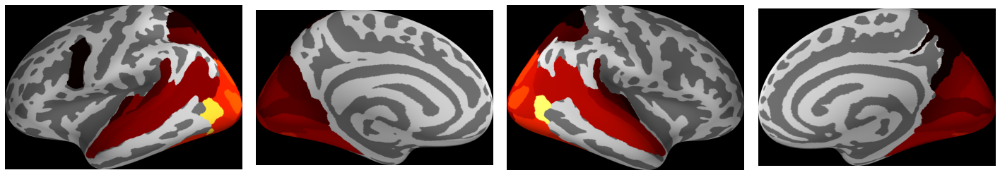

Dimension = 2000
mov1


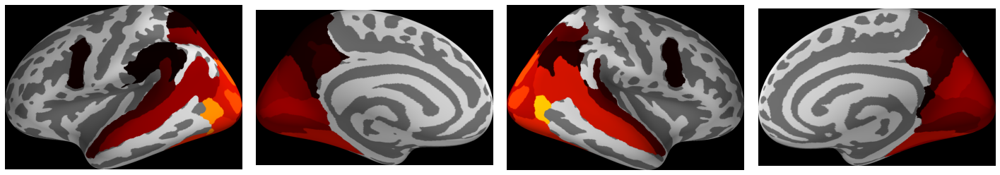

mov2


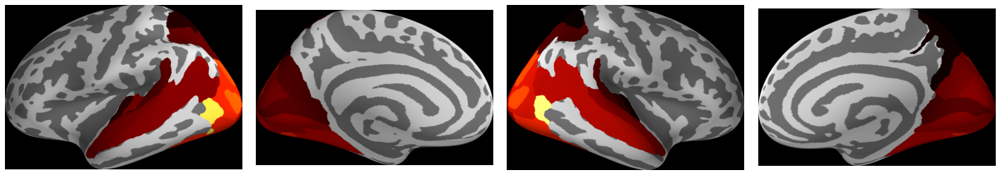

In [30]:
model_idx = 3

out_prefix = os.path.join(out_dir, "pred_acc_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_acc")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Colorbar

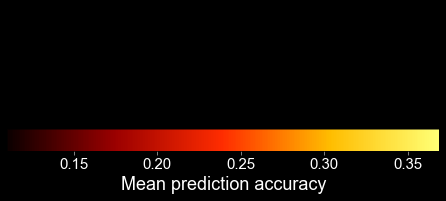

In [31]:
out_name = out_prefix + "_colbar.pdf"

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

fig = plt.figure(facecolor="k")
ax = fig.add_axes((0, 0, 1, 1/3))

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="horizontal")
cbar.set_label("Mean prediction accuracy", color="w")
cbar.ax.spines["bottom"].set_color("w")
cbar.ax.spines["top"].set_color("w")
cbar.ax.spines["left"].set_color("w")
cbar.ax.spines["right"].set_color("w")
cbar.ax.xaxis.label.set_color("w")
cbar.ax.yaxis.label.set_color("w")
cbar.ax.tick_params(axis="x", colors="w", labelsize=15)
cbar.ax.tick_params(axis="y", colors="w")

pp = PdfPages(out_name)
pp.savefig(fig, dpi=300, bbox_inches="tight", facecolor="black")
pp.close()

### Make tables of prediction accuracy

In [32]:
for mi, model in enumerate(all_model_names):
    for movi, mov in enumerate(["mov1", "mov2"]):
        for si, size in enumerate(vecsizes):
            mean_vals = eval(mov + "_roi_acc")[mi][si].mean(axis=1)
            sd_vals = eval(mov + "_roi_acc")[mi][si].std(axis=1, ddof=1)

            pd.DataFrame(np.hstack([roi_names[:, np.newaxis], mean_vals[:, np.newaxis], sd_vals[:, np.newaxis]]), columns=["ROI", "Mean", "SD"]).to_csv(
                "{}/pred_acc_roi_{}_{}_{}.csv".format(out_dir, model, mov, size), index=False)

### Correlation between models

In [33]:
pairs = list(itertools.combinations(range(n_all_models), 2))
n_pairs = len(pairs)

tgt_idx = [3, 4]

for ti in tgt_idx:
    print("Dimension = {}".format(vecsizes[ti]))

    for ps in pairs:
        for i, mov in enumerate(["mov1", "mov2"]):
            x = eval(mov + "_roi_acc")[ps[0]].mean(axis=2)[ti]
            y = eval(mov + "_roi_acc")[ps[1]].mean(axis=2)[ti]
            r, r_p = stats.pearsonr(x, y)
            rho, rho_p = stats.spearmanr(x, y)
            print(" {} & {}, Mov {}: r = {}, p = {}; rho = {}, p = {}".format(all_model_full_names[ps[0]], all_model_full_names[ps[1]], i + 1, r, r_p, rho, rho_p))

Dimension = 1000
 fastText & GloVe, Mov 1: r = 0.9995725238874688, p = 5.930423202816354e-229; rho = 0.9991359600621541, p = 2.4114650583777405e-206
 fastText & GloVe, Mov 2: r = 0.999782926419233, p = 9.94983291771105e-251; rho = 0.9995235335322167, p = 1.8165007710202736e-225
 fastText & Word2vec, Mov 1: r = 0.9997216350792217, p = 9.759209230238392e-243; rho = 0.9993173017775044, p = 6.524466046860523e-214
 fastText & Word2vec, Mov 2: r = 0.9998916128393618, p = 4.7748544745790035e-273; rho = 0.9997546553262908, p = 8.549263306484871e-247
 fastText & Binary-labeling, Mov 1: r = 0.99639371386498, p = 1.8125727463103527e-160; rho = 0.9963162741744508, p = 8.707404844450074e-160
 fastText & Binary-labeling, Mov 2: r = 0.9971479374279232, p = 5.36323160958783e-168; rho = 0.9958753649057558, p = 3.683400217665238e-156
 GloVe & Word2vec, Mov 1: r = 0.9998020863734289, p = 1.06758203472073e-253; rho = 0.9994737534534931, p = 2.831839770207444e-222
 GloVe & Word2vec, Mov 2: r = 0.9998855321

## Table S3-6: Correlation of ROI-wise prediction accuracy between movie sets and between vector dimensions

In [34]:
pairs = list(itertools.combinations(range(2 * n_vecsizes), 2))
n_pairs = len(pairs)

for mi, model in enumerate(model_names):
    mean_vals = np.vstack([mov1_roi_acc[mi].mean(axis=2), mov2_roi_acc[mi].mean(axis=2)])
    rs = np.zeros(n_pairs)
    rhos = np.zeros(n_pairs)
    
    for i, ps in enumerate(pairs):
        rs[i] = stats.pearsonr(mean_vals[ps[0]], mean_vals[ps[1]])[0]
        rhos[i] = stats.spearmanr(mean_vals[ps[0]], mean_vals[ps[1]])[0]

    labels = np.hstack([["Movie set 1, {}".format(x) for x in vecsizes], ["Movie set 2, {}".format(x) for x in vecsizes]])
    pd.DataFrame(distance.squareform(rs), index=labels, columns=labels).to_csv("{}/pred_acc_map_{}_pearson.csv".format(out_dir, model))
    pd.DataFrame(distance.squareform(rhos), index=labels, columns=labels).to_csv("{}/pred_acc_map_{}_spearman.csv".format(out_dir, model))

## Fig. S8: Cortical mapping of voxelwise prediction accuracy

mov1
ftsg
** (inkscape:154381): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


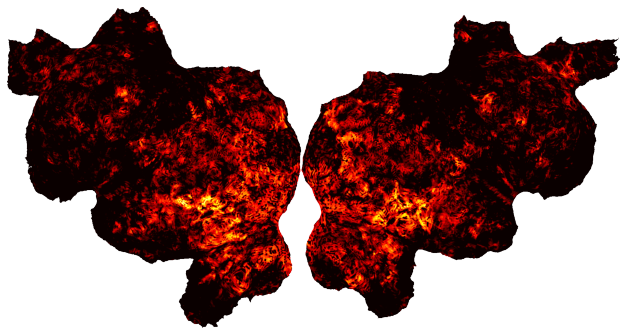

glove
** (inkscape:154397): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


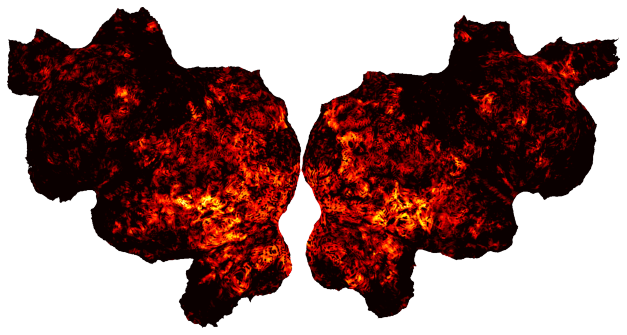

w2vsg
** (inkscape:154414): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


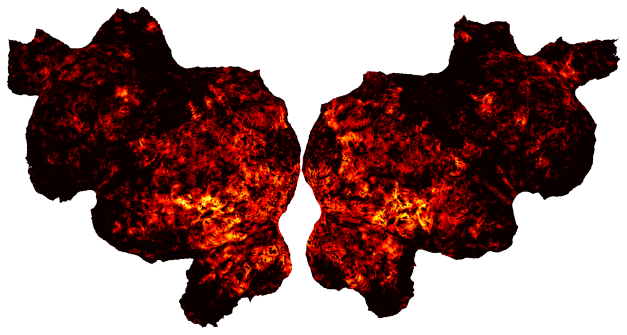

bowbin
** (inkscape:154430): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


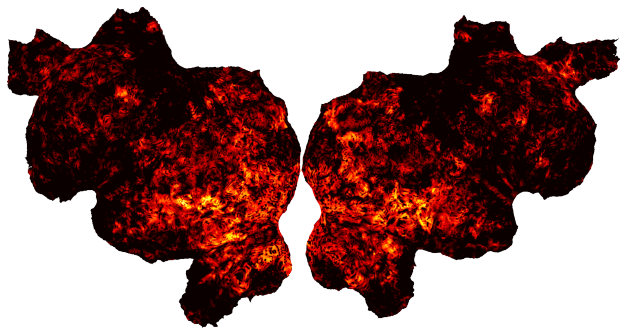

mov2
ftsg
** (inkscape:154446): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


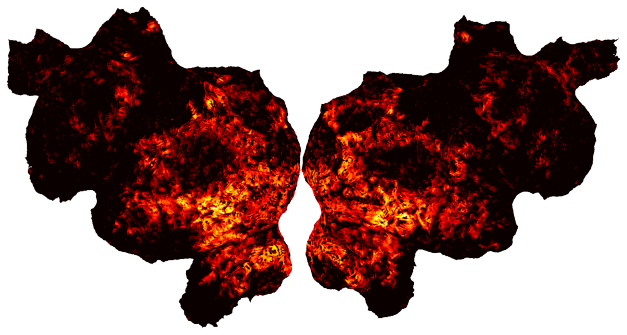

glove
** (inkscape:154462): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


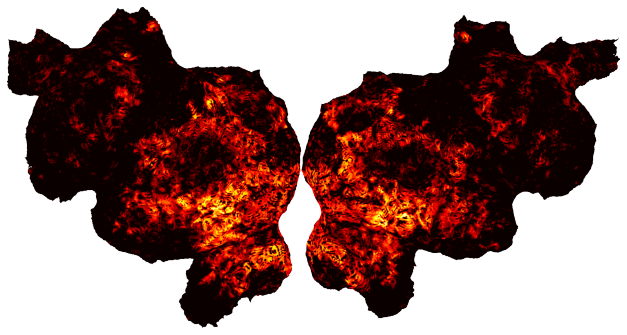

w2vsg
** (inkscape:154478): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


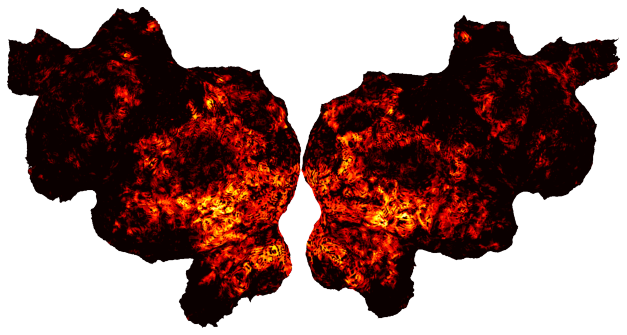

bowbin
** (inkscape:154495): WARNING **: ファイル形式の自動検出が失敗しました。ファイルは SVG として開かれます。


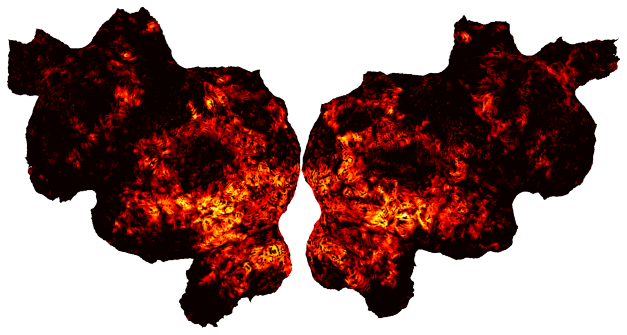

In [35]:
# Max value
mov1_max_vals = [x.max() for x in mov1_subj_acc_epi]
mov2_max_vals = [x.max() for x in mov2_subj_acc_epi]
max_val = np.max(np.vstack([mov1_max_vals, mov2_max_vals]))
min_val = 0.1

for mov in ["mov1", "mov2"]:
    print(mov)
    
    for mi, model in enumerate(all_model_names):
        print(model)
        
        d = eval(mov + "_subj_acc_epi")[mi]
        rot_data = np.transpose(d, (2, 1, 0))
        dv = cortex.Volume(rot_data, pyctx_id, "fullhead", cmap="hot", vmin=min_val, vmax=max_val)
        
        # Save image
        fname = os.path.join(out_dir, "pred_acc_pyctxmap_{}_{}.png".format(model, mov))
        _ = cortex.quickflat.make_png(fname, dv, with_colorbar=False)
        # _ = cortex.quickflat.make_png(fname, dv, with_colorbar=False, recache=True)
        
        # Show image
        plt.figure(figsize=(10, 5))
        plt.imshow(np.array(Image.open(fname)))
        plt.axis("off")
        plt.tight_layout()
        plt.show()

### Colorbar

Value range: 0.1 - 0.7087386250495911


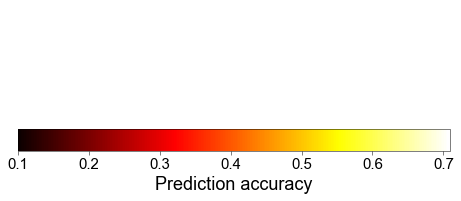

In [36]:
out_name = os.path.join(out_dir, "pred_acc_pyctxmap_colbar.pdf")

print("Value range: {} - {}".format(min_val, max_val))

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

fig = plt.figure()
ax = fig.add_axes((0, 0, 1, 1/3))

mappable = ax.pcolor(X, Y, Z, cmap="hot", vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="horizontal")
cbar.set_label("Prediction accuracy")
cbar.ax.tick_params(axis="x", labelsize=15)

pp = PdfPages(out_name)
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Figs S9: Maximum values of voxelwise prediction accuracy for individual participants

fastText
 mov1
  2000: mean = 0.664032317485128
 mov2
  2000: mean = 0.6606010177731514
GloVe
 mov1
  2000: mean = 0.6623526994671142
 mov2
  2000: mean = 0.6625694796442986
Word2vec
 mov1
  2000: mean = 0.6657389415161951
 mov2
  2000: mean = 0.6618339502811432
Binary-labeling
 mov1
  2000: mean = 0.655803633587701
 mov2
  2000: mean = 0.6597825214266777


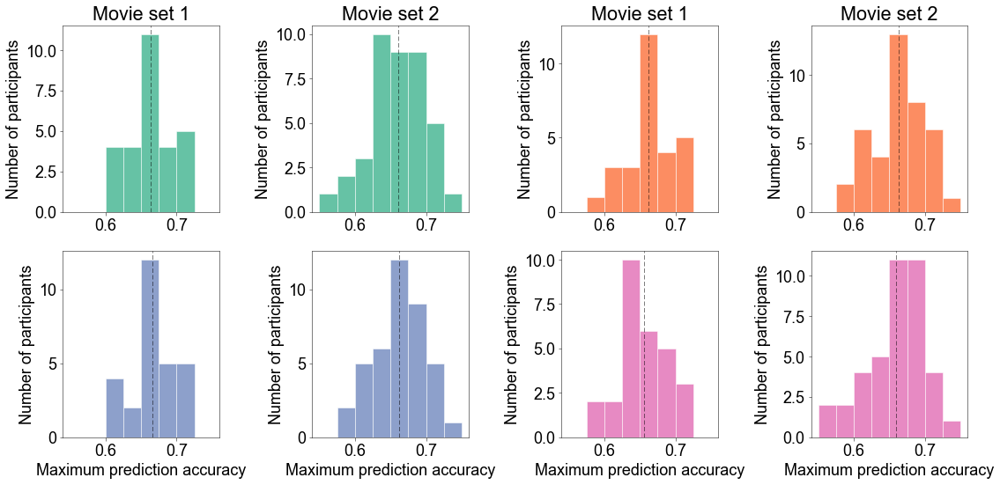

In [37]:
acc_range = [.55, .75]
n_bins = 8
cols = mpl.cm.Set2(range(4))

fig = plt.figure(figsize=(16, 8))

for mi, model in enumerate(all_model_full_names):
    print(model)
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print(" " + mov)
        
        ax = plt.subplot(2, 4, mi * 2 + movi + 1)

        ax.hist(eval(mov + "_maxacc")[mi, dim_idx], bins=n_bins, range=acc_range, ec="w", fc=cols[mi], lw=.5)

        mean_val = eval(mov + "_maxacc")[mi, dim_idx].mean()
        ax.axvline(mean_val, ls="--", dashes=(10, 5), c="k")

        if mi == 2 or mi == 3:
            ax.set_xlabel("Maximum prediction accuracy")

        ax.set_ylabel("Number of participants")
        
        if mi == 0 or mi == 1:
            ax.set_title("Movie set " + str(movi + 1))

        print("  {:4d}: mean = {}".format(size, mean_val))

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'model_maxacc.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Figs. 5, S10–12, S15, and Tables 2, S7-9, S14: Cortical mapping of fraction of significant voxels

In [38]:
# Significance
mov1_rejected = np.zeros((n_all_models, n_vecsizes, n_roi_names))
mov2_rejected = np.zeros((n_all_models, n_vecsizes, n_roi_names))

for mi in range(n_all_models):
    for mov in ["mov1", "mov2"]:
        for vi in range(n_vecsizes):

            pvals = np.ones(n_roi_names)
            for ri in range(n_roi_names):
                if np.any(eval(mov + "_roi_fracsig")[mi, vi, ri] != 0):
                    pvals[ri] = stats.wilcoxon(eval(mov + "_roi_fracsig")[mi, vi, ri] - 0.05)[1]

            eval(mov + "_rejected")[mi, vi] = fdrcorrection(pvals, alpha=thresh_alpha)[0]
        
# Minimum and maximum values of colormaps
mask = np.any(mov1_roi_fracsig[0].mean(axis=2) != 0, axis=0)
min_val = np.min([np.min([x.mean(axis=2)[:, mask].min() for x in mov1_roi_fracsig]),
                  np.min([x.mean(axis=2)[:, mask].min() for x in mov2_roi_fracsig])])
max_val = np.max([np.max([x.mean(axis=2)[:, mask].max() for x in mov1_roi_fracsig]),
                  np.max([x.mean(axis=2)[:, mask].max() for x in mov2_roi_fracsig])])

### fastText

Dimension = 100
mov1


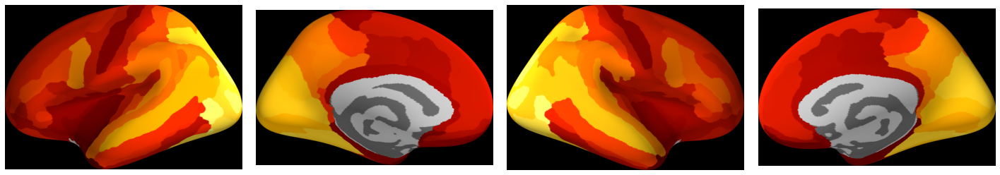

mov2


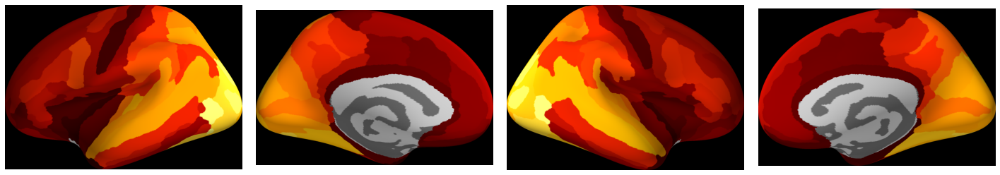

Dimension = 300
mov1


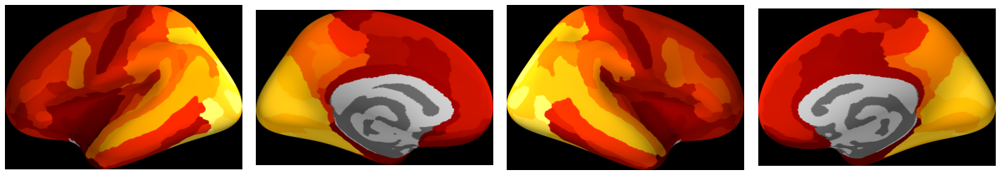

mov2


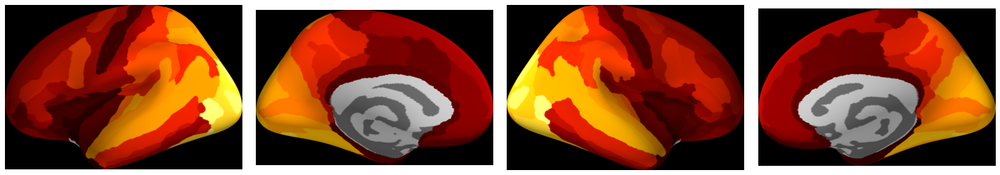

Dimension = 500
mov1


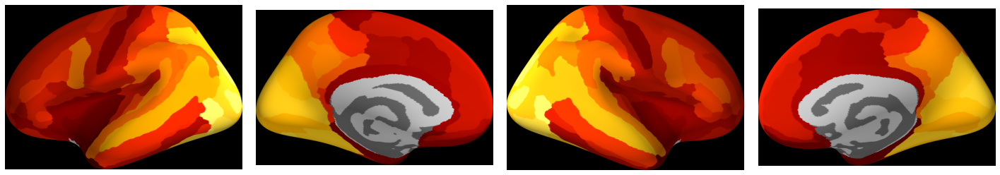

mov2


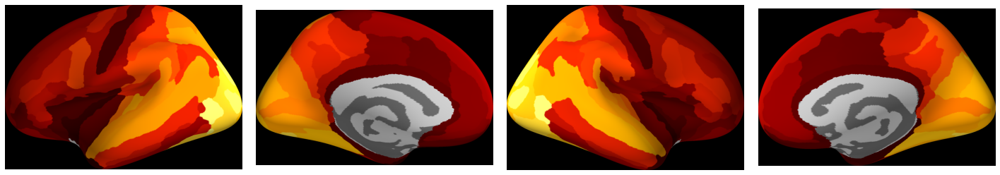

Dimension = 1000
mov1


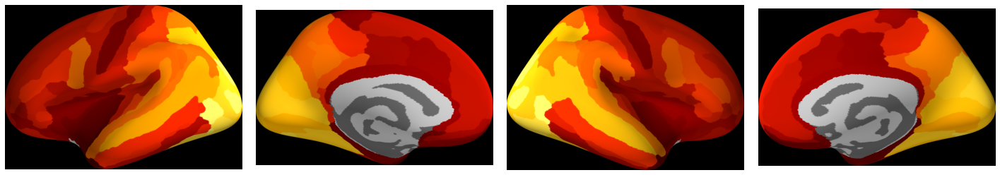

mov2


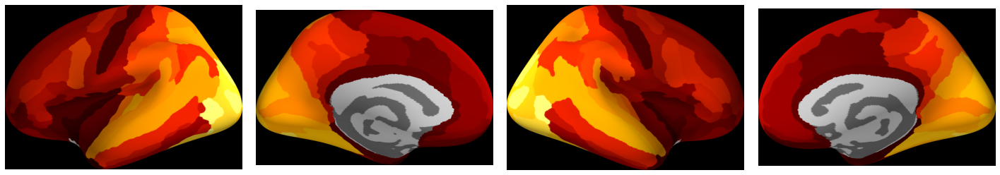

Dimension = 2000
mov1


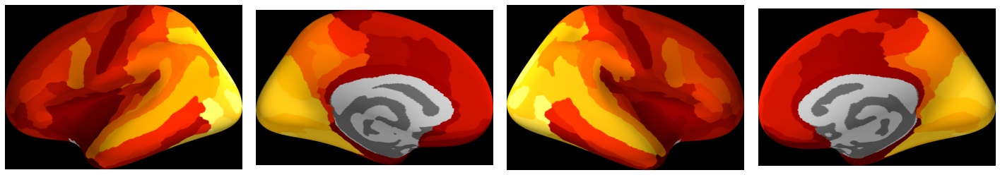

mov2


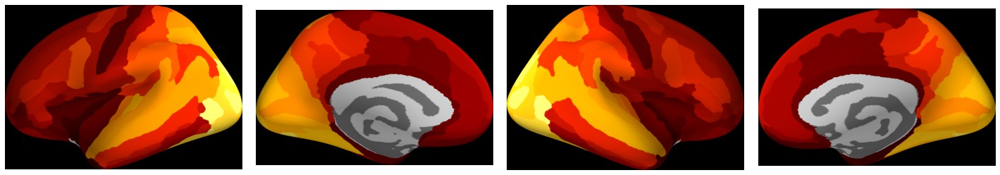

In [39]:
model_idx = 0

out_prefix = os.path.join(out_dir, "fracsig_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1


for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_fracsig")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = np.logical_and(roi_idx[i, :] != -1, eval(label + "_rejected")[model_idx, vi, roi_idx[i, :]])
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### GloVe

Dimension = 100
mov1


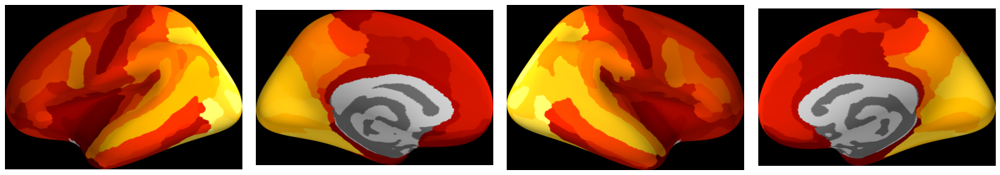

mov2


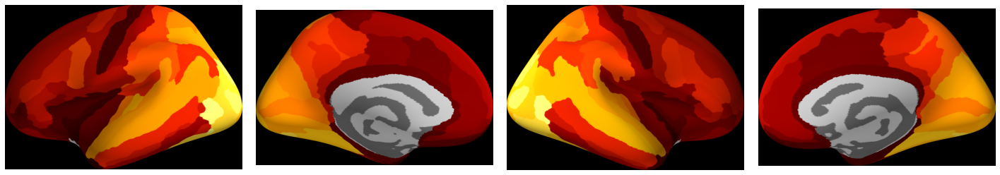

Dimension = 300
mov1


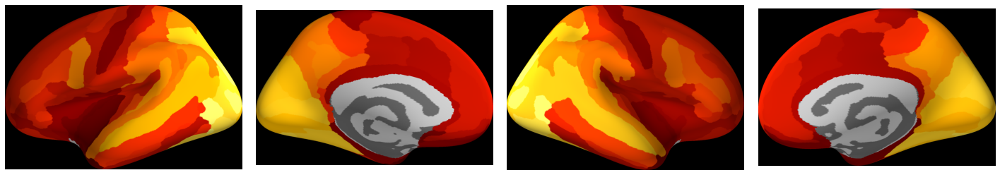

mov2


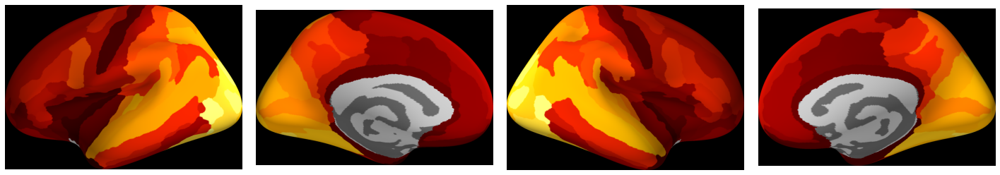

Dimension = 500
mov1


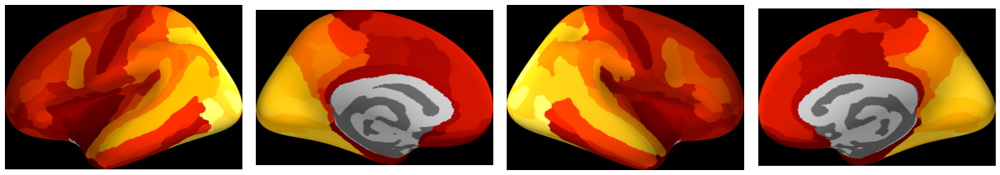

mov2


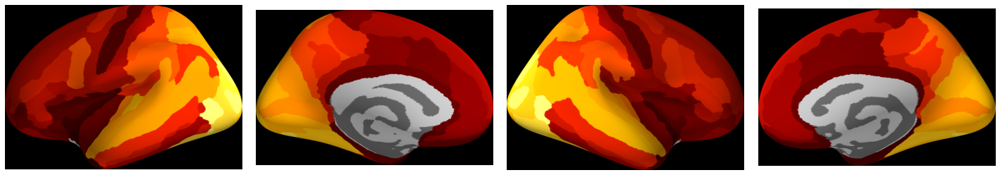

Dimension = 1000
mov1


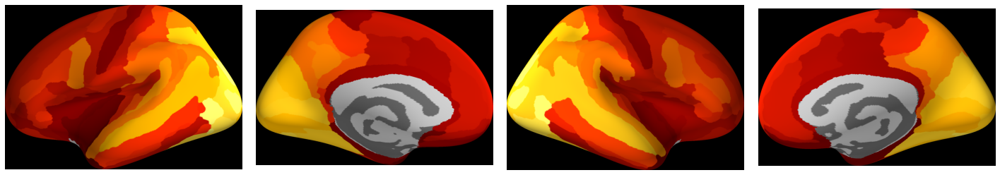

mov2


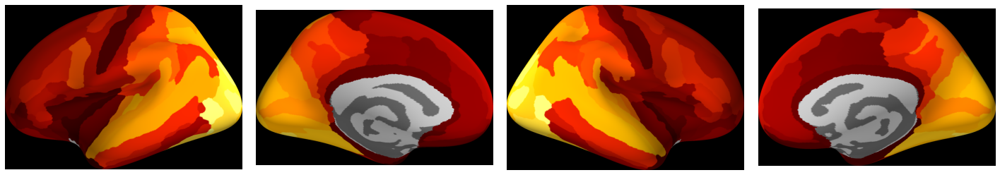

Dimension = 2000
mov1


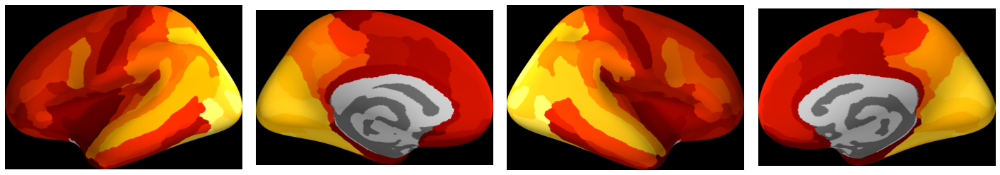

mov2


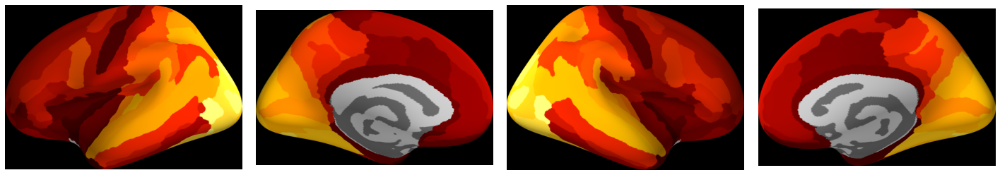

In [40]:
model_idx = 1

out_prefix = os.path.join(out_dir, "fracsig_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1


for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_fracsig")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = np.logical_and(roi_idx[i, :] != -1, eval(label + "_rejected")[model_idx, vi, roi_idx[i, :]])
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Word2vec

Dimension = 100
mov1


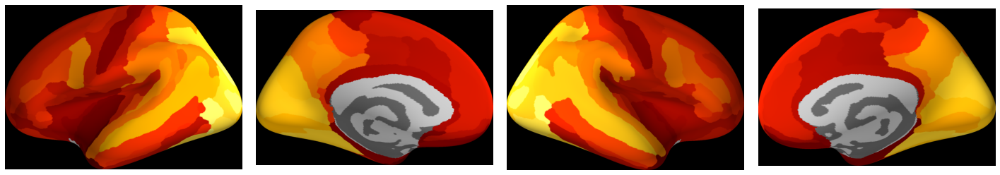

mov2


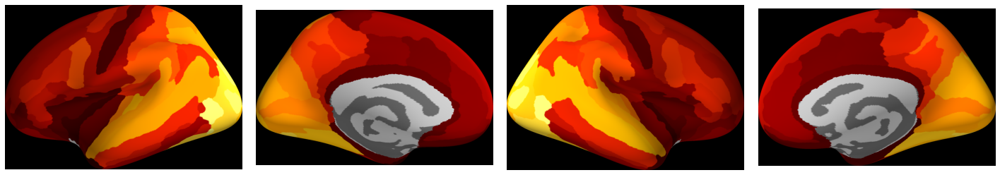

Dimension = 300
mov1


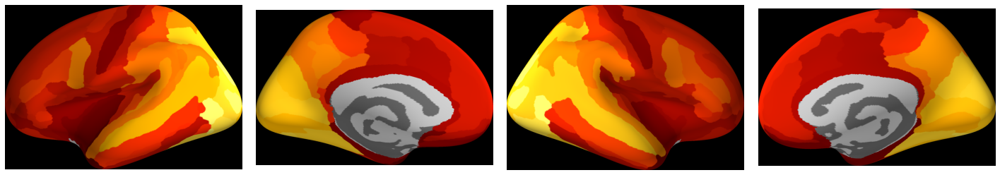

mov2


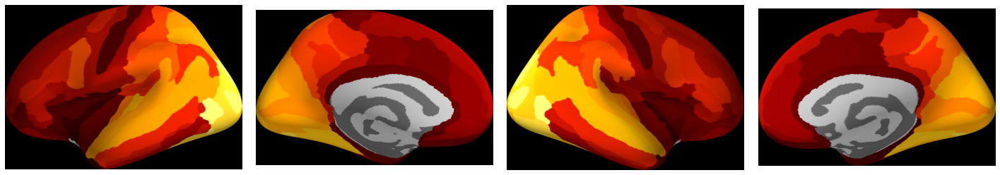

Dimension = 500
mov1


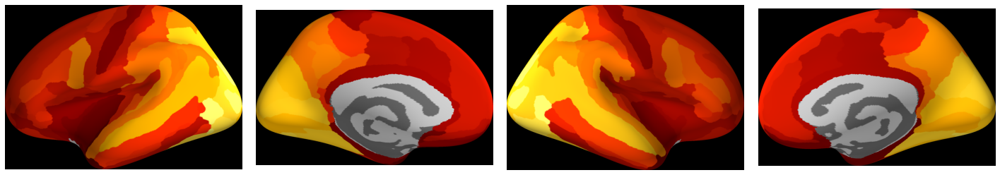

mov2


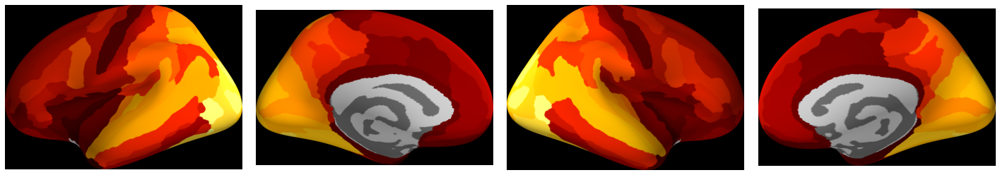

Dimension = 1000
mov1


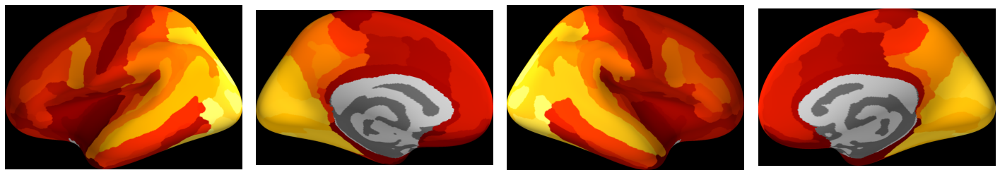

mov2


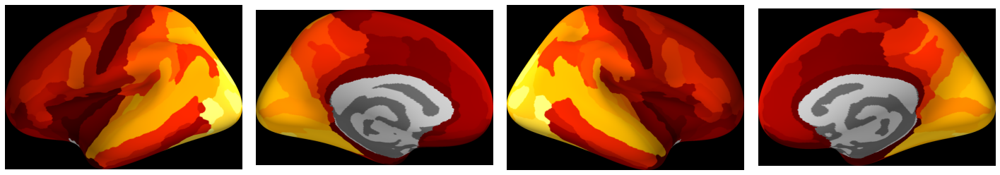

Dimension = 2000
mov1


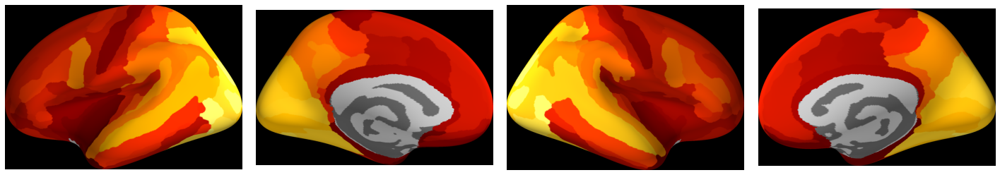

mov2


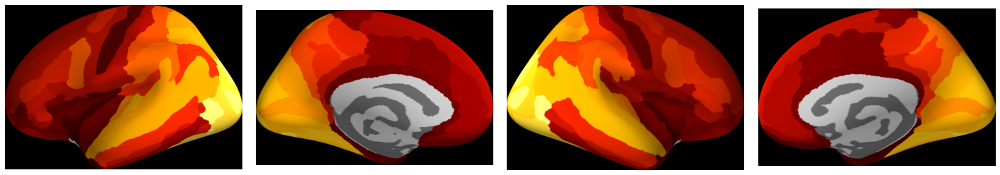

In [41]:
model_idx = 2

out_prefix = os.path.join(out_dir, "fracsig_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1


for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_fracsig")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = np.logical_and(roi_idx[i, :] != -1, eval(label + "_rejected")[model_idx, vi, roi_idx[i, :]])
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Binary-labeling

Dimension = 100
mov1


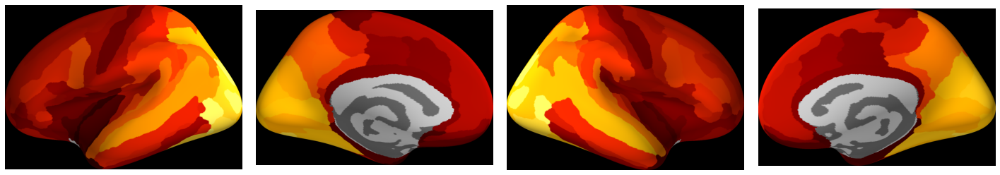

mov2


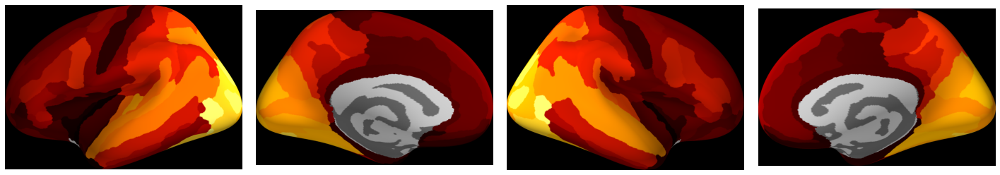

Dimension = 300
mov1


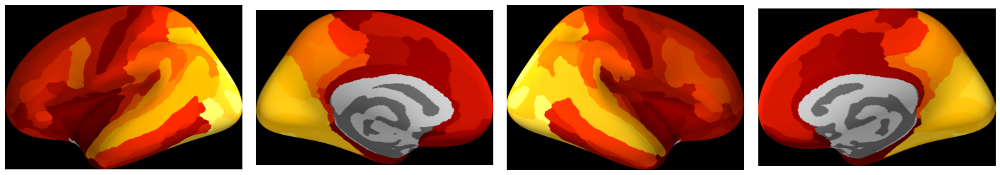

mov2


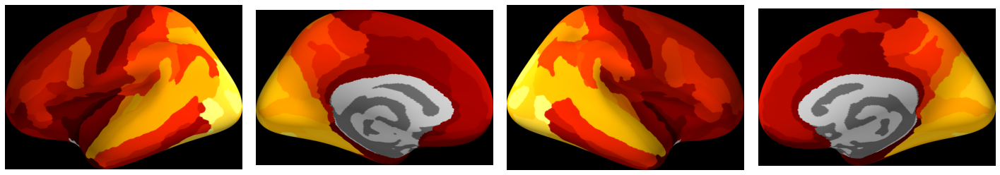

Dimension = 500
mov1


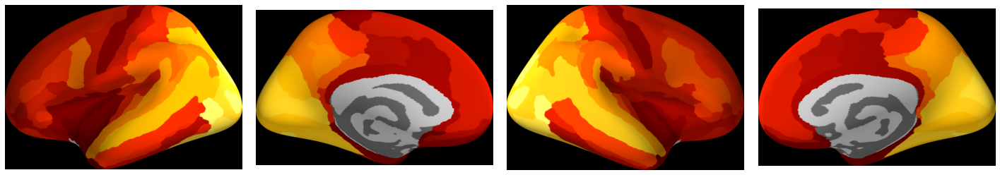

mov2


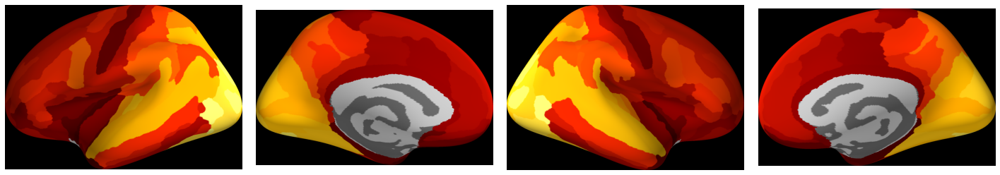

Dimension = 1000
mov1


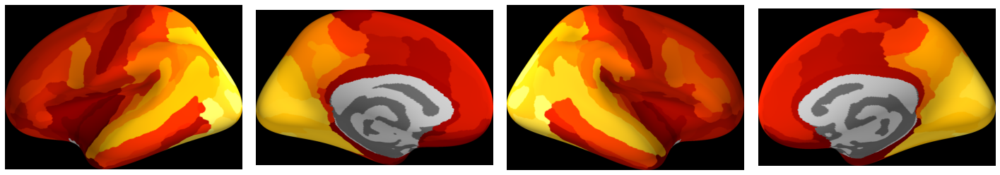

mov2


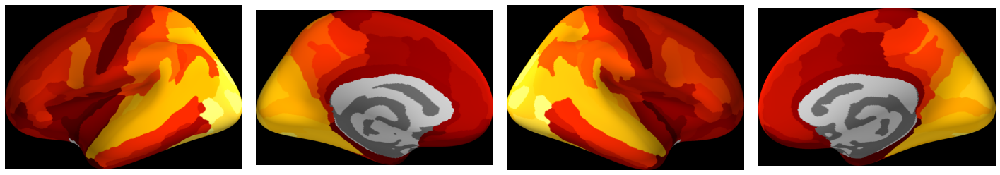

Dimension = 2000
mov1


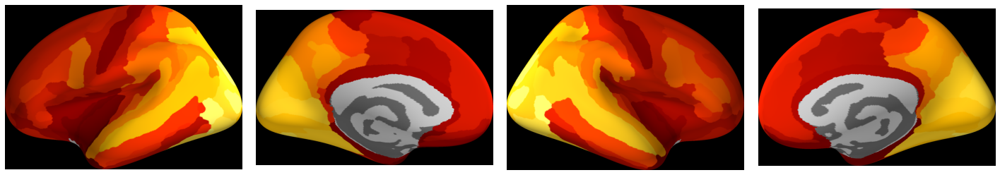

mov2


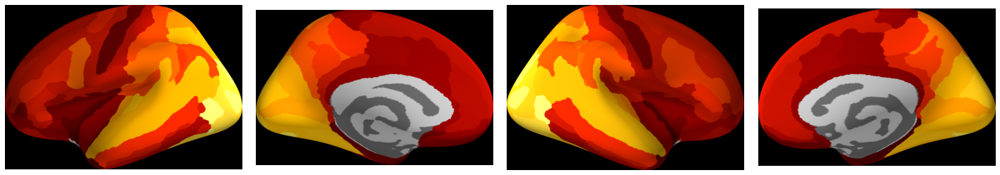

In [42]:
model_idx = 3

out_prefix = os.path.join(out_dir, "fracsig_map")
mov_labels = ["mov1", "mov2"]

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1


for vi, size in enumerate(vecsizes):
    print("Dimension = {}".format(size))
    
    for label in mov_labels:
        print(label)
        
        out_base = "{}_{}_{}_{}".format(out_prefix, all_model_names[model_idx], size, label)

        # Average over participants
        mean_vals = eval(label + "_roi_fracsig")[model_idx][vi].mean(axis=1)

        # Get values for each ROI
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = np.logical_and(roi_idx[i, :] != -1, eval(label + "_rejected")[model_idx, vi, roi_idx[i, :]])
            hemi_vals[i, mask] = mean_vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Colorbar

Min = 0.1902093101629893, Max = 0.9706865934524549


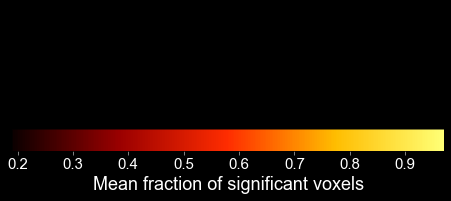

In [43]:
# Colorbar
out_name = out_prefix + "_colbar.pdf"

print("Min = {}, Max = {}".format(min_val, max_val))

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

fig = plt.figure(facecolor="k")
ax = fig.add_axes((0, 0, 1, 1/3))

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="horizontal")
cbar.set_label("Mean fraction of significant voxels", color="w")
cbar.ax.spines["bottom"].set_color("w")
cbar.ax.spines["top"].set_color("w")
cbar.ax.spines["left"].set_color("w")
cbar.ax.spines["right"].set_color("w")
cbar.ax.xaxis.label.set_color("w")
cbar.ax.yaxis.label.set_color("w")
cbar.ax.tick_params(axis="x", colors="w", labelsize=15)
cbar.ax.tick_params(axis="y", colors="w")

pp = PdfPages(out_name)
pp.savefig(fig, dpi=300, bbox_inches="tight", facecolor="black")
pp.close()

### Correlation between movie sets and between vector dimensions

In [44]:
for mi, model in enumerate(all_model_names):
    for movi, mov in enumerate(["mov1", "mov2"]):
        for si, size in enumerate(vecsizes):
            mean_vals = eval(mov + "_roi_fracsig")[mi][si].mean(axis=1)
            sd_vals = eval(mov + "_roi_fracsig")[mi][si].std(axis=1, ddof=1)

            pd.DataFrame(np.hstack([roi_names[:, np.newaxis], mean_vals[:, np.newaxis], sd_vals[:, np.newaxis]]), columns=["ROI", "Mean", "SD"]).to_csv(
                "{}/fracsig_roi_{}_{}_{}.csv".format(out_dir, model, mov, size), index=False)

### Correlation between models

In [45]:
pairs = list(itertools.combinations(range(n_all_models), 2))
n_pairs = len(pairs)

tgt_idx = [3, 4]
        
for ti in tgt_idx:
    print("Dimension = {}".format(vecsizes[ti]))

    for ps in pairs:
        for i, mov in enumerate(["mov1", "mov2"]):
            x = eval(mov + "_roi_fracsig")[ps[0]].mean(axis=2)[ti]
            y = eval(mov + "_roi_fracsig")[ps[1]].mean(axis=2)[ti]
            r, r_p = stats.pearsonr(x, y)
            rho, rho_p = stats.spearmanr(x, y)
            print(" {} & {}, Mov {}: r = {}, p = {}; rho = {}, p = {}".format(all_model_full_names[ps[0]], all_model_full_names[ps[1]], i + 1, r, r_p, rho, rho_p))

Dimension = 1000
 fastText & GloVe, Mov 1: r = 0.9993482897902461, p = 2.0995948228381693e-215; rho = 0.9990257327449803, p = 1.7347368553372375e-202
 fastText & GloVe, Mov 2: r = 0.9995310331168735, p = 5.616691840552015e-226; rho = 0.9990826242635217, p = 2.0250717426057098e-204
 fastText & Word2vec, Mov 1: r = 0.9993239890290982, p = 3.1499055371366106e-214; rho = 0.9991039585829746, p = 3.552679375272134e-205
 fastText & Word2vec, Mov 2: r = 0.9996888415684828, p = 3.6988329989913538e-239; rho = 0.9994559748539489, p = 3.308182661961018e-221
 fastText & Binary-labeling, Mov 1: r = 0.9966579920812778, p = 6.554438704833346e-163; rho = 0.99595359074375, p = 8.955936814256757e-157
 fastText & Binary-labeling, Mov 2: r = 0.9960937368857811, p = 6.62967244115842e-158; rho = 0.9948442061321947, p = 5.26533026625721e-149
 GloVe & Word2vec, Mov 1: r = 0.9996398614867101, p = 1.8425109138552352e-234; rho = 0.9993635261363193, p = 3.6483924074664225e-216
 GloVe & Word2vec, Mov 2: r = 0.99982

## Table S10-12: Correlation between movie sets and between vector dimensions

In [46]:
pairs = list(itertools.combinations(range(2 * n_vecsizes), 2))
n_pairs = len(pairs)

for mi, model in enumerate(model_names):
    mean_vals = np.vstack([mov1_roi_fracsig[mi].mean(axis=2), mov2_roi_fracsig[mi].mean(axis=2)])
    rs = np.zeros(n_pairs)
    rhos = np.zeros(n_pairs)
    
    for i, ps in enumerate(pairs):
        rs[i] = stats.pearsonr(mean_vals[ps[0]], mean_vals[ps[1]])[0]
        rhos[i] = stats.spearmanr(mean_vals[ps[0]], mean_vals[ps[1]])[0]

    labels = np.hstack([["Movie set 1, {}".format(x) for x in vecsizes], ["Movie set 2, {}".format(x) for x in vecsizes]])
    pd.DataFrame(distance.squareform(rs), index=labels, columns=labels).to_csv("{}/fracsig_map_{}_pearson.csv".format(out_dir, model))
    pd.DataFrame(distance.squareform(rhos), index=labels, columns=labels).to_csv("{}/fracsig_map_{}_spearman.csv".format(out_dir, model))

## Fig. S12: Comparison of significant-voxel fraction with the performance of control models

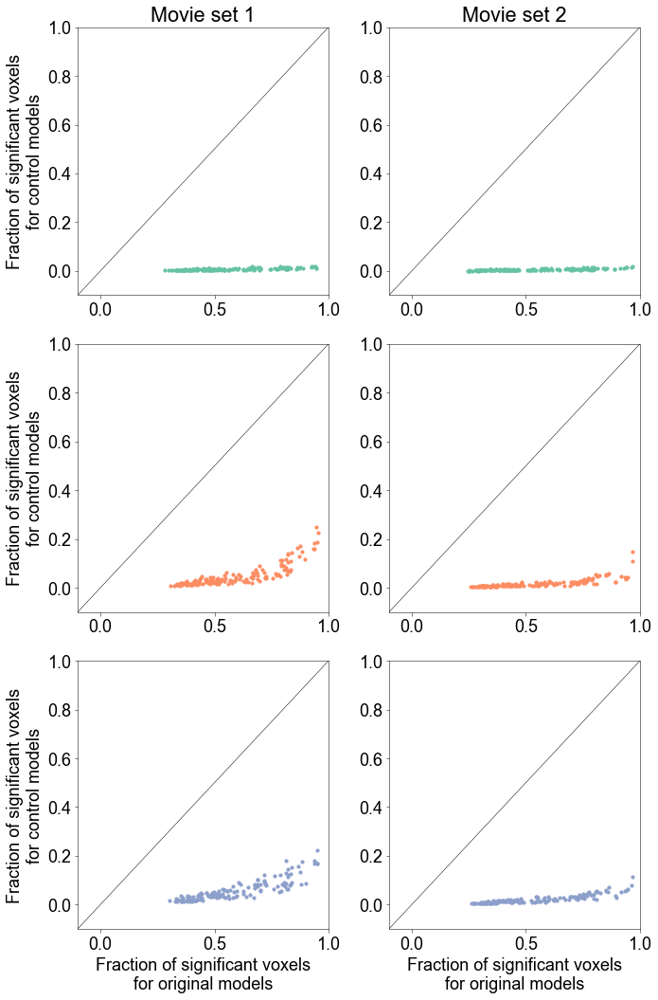

In [47]:
min_val = -.1
max_val = 1

cols = mpl.cm.Set2(range(3))

fig = plt.figure(figsize=[10, 15])
    
for mi, model in enumerate(ctrl_model_names):
    for movi, mov in enumerate(["mov1", "mov2"]):
        
        mask = np.all(eval(mov + "_roi_n_voxels") != 0, axis=1)
        n_samps = mask.sum()
        
        ax = plt.subplot(n_ctrl_models, 2, mi * 2 + movi + 1)
        
        x = eval(mov + "_roi_fracsig")[mi, dim_idx, mask]
        y = eval(mov + "_roi_ctrl_fracsig")[mi][mask]
        
        ax.scatter(x.mean(axis=1), y.mean(axis=1), marker="o", s=10, fc=cols[mi])
        ax.plot([min_val, max_val], [min_val, max_val], "k-")
        
        ax.set_xlim([min_val, max_val])
        ax.set_ylim([min_val, max_val])
        
        if mi == n_ctrl_models - 1:
            ax.set_xlabel("Fraction of significant voxels\nfor original models")
        if movi == 0:
            ax.set_ylabel("Fraction of significant voxels\nfor control models")
            
        if mi == 0:
            if movi == 0:
                ax.set_title("Movie set 1")
            else:
                ax.set_title("Movie set 2")
            
fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "frac_sig_cmpr_ctrl.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

In [48]:
# Statistics
pvals = []

for mi, model in enumerate(ctrl_model_names):
    print(model)
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print(" " + mov)
        
        mask = np.all(eval(mov + "_roi_n_voxels") != 0, axis=1)
        
        x = eval(mov + "_roi_fracsig")[mi][dim_idx, mask]
        y = eval(mov + "_roi_ctrl_fracsig")[mi][mask]
        
        ps = [stats.wilcoxon(xx, yy)[1] for xx, yy in zip(x, y)]
        pvals.append(ps)
        
        print("  Orig model: mean = {}".format(x.mean()))
        print("  Ctrl model: mean = {}".format(y.mean()))
        
corr_pvals = fdrcorrection(np.hstack(pvals), alpha=thresh_alpha)[1]
print("Max corrected p = {}".format(np.max(corr_pvals)))

ftsgshuf
 mov1
  Orig model: mean = 0.5685161917643862
  Ctrl model: mean = 0.007024832244266835
 mov2
  Orig model: mean = 0.5223066869070285
  Ctrl model: mean = 0.00525614661909179
gloveshuf
 mov1
  Orig model: mean = 0.5833252239874156
  Ctrl model: mean = 0.04911525527031359
 mov2
  Orig model: mean = 0.5367596875057881
  Ctrl model: mean = 0.017416336991293777
w2vsgshuf
 mov1
  Orig model: mean = 0.587708457206667
  Ctrl model: mean = 0.05995811933242689
 mov2
  Orig model: mean = 0.5391102941807348
  Ctrl model: mean = 0.021786098694597144
Max corrected p = 3.789619441580871e-06


## Fig. 6: Example set of dissimilarity matrices

Dimension = 1000
Noun
Adjective


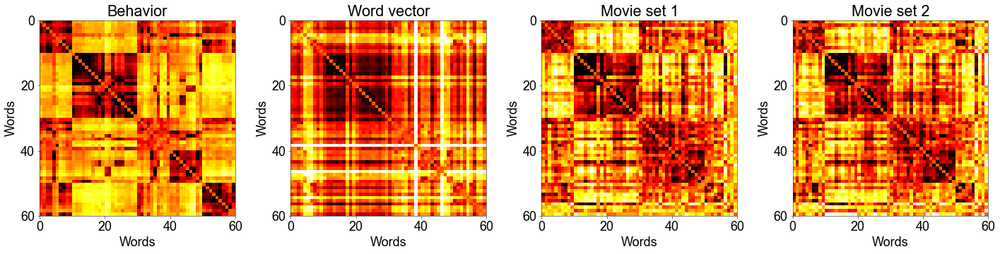

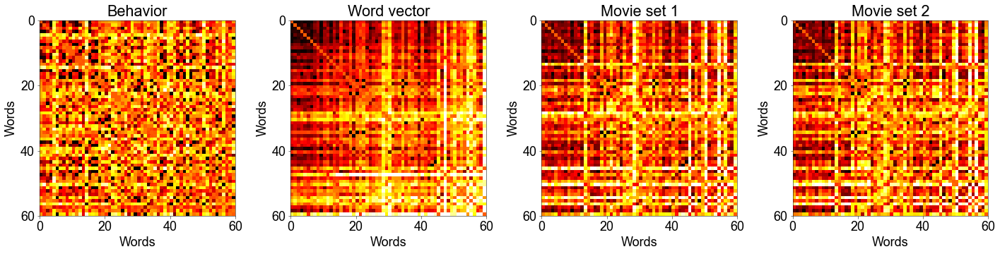

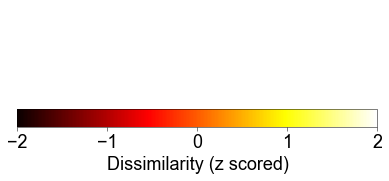

In [49]:
model_idx = 0  # fastText

# Behavior
behav_noun_mean_dissim = stats.zscore(behav_noun_dissim.mean(axis=0))
behav_adj_mean_dissim = stats.zscore(behav_adj_dissim.mean(axis=0))

# Brain
mov1_noun_mean_dissim = stats.zscore(mov1_noun_dissim[model_idx][dim_idx])
mov1_adj_mean_dissim = stats.zscore(mov1_adj_dissim[model_idx][dim_idx])

mov2_noun_mean_dissim = stats.zscore(mov2_noun_dissim[model_idx][dim_idx])
mov2_adj_mean_dissim = stats.zscore(mov2_adj_dissim[model_idx][dim_idx])

# Word vector
wv_noun_mean_dissim = stats.zscore(wv_noun_dissim[model_idx][dim_idx])
wv_adj_mean_dissim = stats.zscore(wv_adj_dissim[model_idx][dim_idx])

print("Dimension = {}".format(vecsizes[dim_idx]))

prefixes = ["behav", "wv", "mov1", "mov2"]
titles = ["Behavior", "Word vector", "Movie set 1", "Movie set 2"]

min_val = -2
max_val = 2

# Noun

print("Noun")

fig = plt.figure(figsize=(20, 5))

for i, (p, t) in enumerate(zip(prefixes, titles)):
    ax = plt.subplot(1, 4, i + 1)
    ax.pcolor(distance.squareform(eval(p + "_noun_mean_dissim")), vmin=min_val, vmax=max_val, cmap="hot")
    ax.axis("square")

    ax.set_xlabel("Words")
    ax.set_xticks(np.linspace(0, 60, 4))
    ax.invert_yaxis()
    ax.set_ylabel("Words")
    ax.set_yticks(np.linspace(0, 60, 4))
    ax.set_title(t)

plt.tight_layout()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_mat_noun.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

##
# Adjective

print("Adjective")

fig = plt.figure(figsize=(20, 5))

for i, (p, t) in enumerate(zip(prefixes, titles)):
    ax = plt.subplot(1, 4, i + 1)
    ax.pcolor(distance.squareform(eval(p + "_adj_mean_dissim")), vmin=min_val, vmax=max_val, cmap="hot")
    ax.axis("square")

    ax.set_xlabel("Words")
    ax.set_xticks(np.linspace(0, 60, 4))
    ax.invert_yaxis()
    ax.set_ylabel("Words")
    ax.set_yticks(np.linspace(0, 60, 4))
    ax.set_title(t)

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_mat_adj.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

##
# Color bar

# Colorbar
fig = plt.figure(figsize=(5, 5))
ax = fig.add_axes((0, 0, 1, 1/3))

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

m = ax.pcolor(X, Y, Z, cmap="hot", vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(m, ax=ax, orientation="horizontal")
cbar.set_label("Dissimilarity (z scored)")

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_mat_colorbar.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

### Correlation

In [50]:
print("Dimension = {}".format(vecsizes[dim_idx]))

for pos in ["noun", "adj"]:

    print(pos + ":")

    coef = stats.spearmanr(eval("behav_" + pos + "_mean_dissim"), eval("mov1_" + pos + "_mean_dissim"))[0]
    samps = eval("mov1_" + pos + "_corr_perm_samps")[0, dim_idx]
    pval = np.sum(samps > coef) / len(samps)
    print(" Behav & Mov1: rho = {}, p = {}".format(coef, pval))

    coef = stats.spearmanr(eval("behav_" + pos + "_mean_dissim"), eval("mov2_" + pos + "_mean_dissim"))[0]
    samps = eval("mov2_" + pos + "_corr_perm_samps")[0, dim_idx]
    pval = np.sum(samps > coef) / len(samps)
    print(" Behav & Mov2: rho = {}, p = {}".format(coef, pval))

    coef = stats.spearmanr(eval("behav_" + pos + "_mean_dissim"), eval("wv_" + pos + "_mean_dissim"))[0]
    samps = eval("wv_" + pos + "_corr_perm_samps")[0, dim_idx]
    pval = np.sum(samps > coef) / len(samps)
    print(" Behav & WV: rho = {}, p = {}".format(coef, pval))
    
    coef = stats.spearmanr(eval("mov1_" + pos + "_mean_dissim"), eval("mov2_" + pos + "_mean_dissim"))[0]
    print(" Mov1 & Mov2: rho = {}".format(coef))

Dimension = 1000
noun:
 Behav & Mov1: rho = 0.5799557501951096, p = 0.0
 Behav & Mov2: rho = 0.5915850225059056, p = 0.0
 Behav & WV: rho = 0.24929422573420804, p = 0.0
 Mov1 & Mov2: rho = 0.9260671681674851
adj:
 Behav & Mov1: rho = 0.3300975685372818, p = 0.0
 Behav & Mov2: rho = 0.3395462796598294, p = 0.0
 Behav & WV: rho = 0.22535934213874073, p = 0.0
 Mov1 & Mov2: rho = 0.9425771898785185


## Fig. 7: Behavioral correlation for all models

In [51]:
n_word_pairs = int(n_nouns * (n_nouns - 1) / 2)

behav_mean_dissim = np.zeros((2, n_word_pairs))  # POS x word pair
br_mean_dissim = np.zeros((2, n_models, 2, n_word_pairs))  # POS x model x movie set x word pair
wv_mean_dissim = np.zeros((2, n_models, n_word_pairs))  # POS x mdoel x word pair

br_rvals = np.zeros((2, n_models, 2))  # POS x model x movie set
br_pvals = np.zeros((2, n_models, 2))
wv_rvals = np.zeros((2, n_models))  # POS x model
wv_pvals = np.zeros((2, n_models))

model_pairs = list(itertools.combinations(range(n_models), 2))
n_model_pairs = len(model_pairs)

model_cmpr_br_pvals = np.zeros((2, 2, n_model_pairs))  # POS x movie set x model pair
model_cmpr_wv_pvals = np.zeros((2, n_model_pairs))  # POS x model pair

brwv_cmpr_pvals = np.zeros((2, n_models, 2))  # POS x model x movie set

for posi, pos in enumerate(["noun", "adj"]):
    behav_mean_dissim[posi] = eval("behav_" + pos + "_dissim").mean(axis=0)
    
    for mi, model in enumerate(model_names):
        wv_mean_dissim[posi, mi] = eval("wv_" + pos + "_dissim")[mi][dim_idx]
        wv_rvals[posi, mi] = stats.spearmanr(behav_mean_dissim[posi], wv_mean_dissim[posi, mi])[0]
        samps = eval(f"wv_{pos}_corr_perm_samps")[mi, dim_idx]
        wv_pvals[posi, mi] = np.sum(samps > wv_rvals[posi, mi]) / len(samps)
        
        for movi, mov in enumerate(["mov1", "mov2"]):
            br_mean_dissim[posi, mi, movi] = eval(mov + "_" + pos + "_dissim")[mi][dim_idx]
            br_rvals[posi, mi, movi] = stats.spearmanr(behav_mean_dissim[posi], br_mean_dissim[posi, mi, movi])[0]
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[mi, dim_idx]
            br_pvals[posi, mi, movi] = np.sum(samps > br_rvals[posi, mi, movi]) / len(samps)
            
    # Statistical comparison between models
    for pairi, pair in enumerate(model_pairs):
        samps = eval(f"wv_{pos}_corr_perm_samps")[pair[0], dim_idx] - eval(f"wv_{pos}_corr_perm_samps")[pair[1], dim_idx]
        p = np.sum(samps > (wv_rvals[posi, pair[0]] - wv_rvals[posi, pair[1]])) / len(samps)
        if p > 0.5:
            p = 1 - p
        model_cmpr_wv_pvals[posi, pairi] = p
        
        for movi, mov in enumerate(["mov1", "mov2"]):
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[pair[0], dim_idx] - eval(f"{mov}_{pos}_corr_perm_samps")[pair[1], dim_idx]
            p = np.sum(samps > (br_rvals[posi, pair[0], movi] - br_rvals[posi, pair[1], movi])) / len(samps)
            if p > 0.5:
                p = 1 - p
            model_cmpr_br_pvals[posi, movi, pairi] = p
            
    # Statistical comparison between brain and word vector
    for mi, model in enumerate(model_names):
        for movi, mov in enumerate(["mov1", "mov2"]):
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[mi, dim_idx] - eval(f"wv_{pos}_corr_perm_samps")[mi, dim_idx]
            p = np.sum(samps > (br_rvals[posi, mi, movi] - wv_rvals[posi, mi])) / len(samps)
            if p > 0.5:
                p = 1 - p
            brwv_cmpr_pvals[posi, mi, movi] = p

# Statistical comparison between POSs
pos_cmpr_br_pvals = np.zeros((n_models, 2))  # model x movie set
pos_cmpr_wv_pvals = np.zeros(n_models)  # model

for mi, model in enumerate(model_names):
    samps = eval("wv_noun_corr_perm_samps")[mi, dim_idx] - eval("wv_adj_corr_perm_samps")[mi, dim_idx]
    p = np.sum(samps > (wv_rvals[0, mi] - wv_rvals[1, mi])) / len(samps)
    if p > 0.5:
        p = 1 - p
    pos_cmpr_wv_pvals[mi] = p
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        samps = eval(f"{mov}_noun_corr_perm_samps")[mi, dim_idx] - eval(f"{mov}_adj_corr_perm_samps")[mi, dim_idx]
        p = np.sum(samps > (br_rvals[0, mi, movi] - br_rvals[1, mi, movi])) / len(samps)
        if p > 0.5:
            p = 1 - p
        pos_cmpr_br_pvals[mi, movi] = p

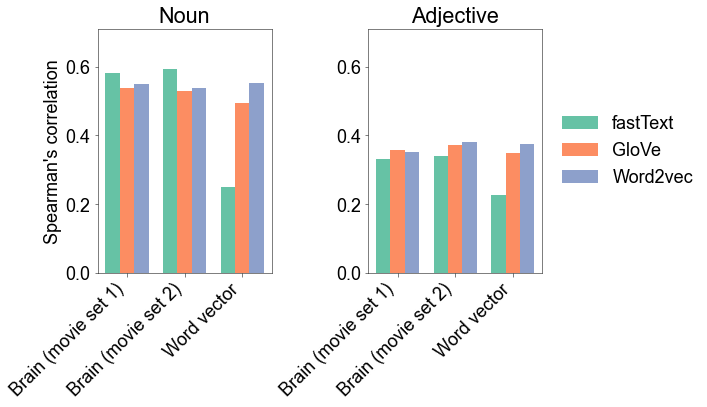

In [52]:
# Plot
title_labs = ["Noun", "Adjective"]
x = np.arange(3)
width = 0.25

y_max = np.hstack((wv_rvals.ravel(), br_rvals.ravel())).max() * 1.2

fig = plt.figure(figsize=[10, 6])

for posi, pos in enumerate(["noun", "adj"]):
    
    ax = plt.subplot(1, 2, posi + 1)
    
    handles = []
    for mi in range(n_models):
        for movi, mov in enumerate(["mov1", "mov2"]):
            r = br_rvals[posi, mi, movi]
            ax.bar(x[movi] + width * (mi - 1), r, width=width, fc=mpl.cm.Set2(mi))
            
        r = wv_rvals[posi, mi]
        h = ax.bar(x[2] + width * (mi - 1), r, width=width, fc=mpl.cm.Set2(mi))
        handles.append(h)
    
    if posi == 1:
        ax.legend(handles, model_full_names, bbox_to_anchor=(1.02, 0.5), loc="center left", frameon=False)
    
    ax.set_xticks(x)
    ax.set_xticklabels(["Brain (movie set 1)", "Brain (movie set 2)", "Word vector"], rotation=45, ha="right")
    if posi == 0:
        ax.set_ylabel("Spearman's correlation")
    ax.set_ylim([0, y_max])
    ax.set_title(title_labs[posi])

fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

In [53]:
# Statistics

# Significance of correlations
print("Significance of correlations")

pvals = np.concatenate((wv_pvals[:, :, np.newaxis], br_pvals), axis=2)
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

for posi, pos in enumerate(["Noun", "Adj"]):
    print("** {} **".format(pos))
    
    for mi, model in enumerate(model_full_names):
        print("{}".format(model))
        
        for j, dset in enumerate(["WV", "Mov1", "Mov2"]):
            print("  {}: p = {}".format(dset, corr_pvals[posi, mi, j]))

print()

# Comparison between models
print("Comparison between models")

pairs = list(itertools.combinations(model_full_names, 2))

pvals = np.concatenate((model_cmpr_wv_pvals.reshape((2, 1, len(pairs))), model_cmpr_br_pvals), axis=1)
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

for posi, pos in enumerate(["Noun", "Adj"]):
    print("** {} **".format(pos))
    
    for i, ps in enumerate(pairs):
        print("{} vs {}".format(ps[0], ps[1]))
        
        for j, dset in enumerate(["WV", "Mov1", "Mov2"]):
            print("  {}: p = {}".format(dset, corr_pvals[posi, j, i]))
            
print()

# Comparison between brain and word vectors
print("Comparison between brain and word vectors")

corr_pvals = fdrcorrection(brwv_cmpr_pvals.ravel(), alpha=thresh_alpha)[1].reshape(brwv_cmpr_pvals.shape)

for posi, pos in enumerate(["Noun", "adj"]):
    print("** {} **".format(pos))
    
    for mi, model in enumerate(model_names):
        print("{}".format(model))
        
        for movi, mov in enumerate(["Mov1", "Mov2"]):
            print("  {}: p = {}".format(mov, corr_pvals[posi, mi, movi]))

print()

# Comparison between POSs
print("Comparison between POSs")

pvals = np.concatenate((pos_cmpr_wv_pvals[:, np.newaxis], pos_cmpr_br_pvals), axis=1)
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

for mi, model in enumerate(model_full_names):
    print(model)
    
    for j, dset in enumerate(["WV", "Mov1", "Mov2"]):
        print("  {}: p = {}".format(dset, corr_pvals[mi, j]))

Significance of correlations
** Noun **
fastText
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0
GloVe
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0
Word2vec
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0
** Adj **
fastText
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0
GloVe
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0
Word2vec
  WV: p = 0.0
  Mov1: p = 0.0
  Mov2: p = 0.0

Comparison between models
** Noun **
fastText vs GloVe
  WV: p = 0.0
  Mov1: p = 0.018000000000000002
  Mov2: p = 0.0021599999999999996
fastText vs Word2vec
  WV: p = 0.0
  Mov1: p = 0.07236
  Mov2: p = 0.0051
GloVe vs Word2vec
  WV: p = 0.010542857142857123
  Mov1: p = 0.10875000000000001
  Mov2: p = 0.15277500000000005
** Adj **
fastText vs GloVe
  WV: p = 0.0
  Mov1: p = 0.14112000000000005
  Mov2: p = 0.10875000000000001
fastText vs Word2vec
  WV: p = 0.0
  Mov1: p = 0.12368571428571422
  Mov2: p = 0.022199999999999998
GloVe vs Word2vec
  WV: p = 0.11284615384615387
  Mov1: p = 0.3696
  Mov2: p = 0.284929411764705

## Fig. S16: Behavioral correlation for all vector dimensions of fastText

In [54]:
model_idx = 0
model = model_names[model_idx]

# Correlation with behavior

n_vecsizes = mov1_noun_dissim[model_idx].shape[0]

br_coefs = np.zeros((2, 2, n_vecsizes))  # POS x movie set x dimension
br_pvals = np.ones((2, 2, n_vecsizes))

wv_coefs = np.zeros((2, n_vecsizes))  # POS x dimension
wv_pvals = np.zeros((2, n_vecsizes))

n_word_pairs = int(n_nouns * (n_nouns - 1) / 2)

behav_mean_dissim = np.zeros((2, n_word_pairs))
brain_mean_dissim = np.zeros((2, 2, n_vecsizes, n_word_pairs))
wv_mean_dissim = np.zeros((2, n_vecsizes, n_word_pairs))

for posi, pos in enumerate(["noun", "adj"]):
    
    behav_mean_dissim[posi] = eval("behav_" + pos + "_dissim").mean(axis=0)
    
    wv_mean_dissim[posi] = eval("wv_" + pos + "_dissim")[model_idx]
    for vi in range(n_vecsizes):
        wv_coefs[posi, vi] = stats.spearmanr(wv_mean_dissim[posi, vi], behav_mean_dissim[posi])[0]
        
        samps = eval(f"wv_{pos}_corr_perm_samps")[model_idx, vi]
        p = np.sum(samps > wv_coefs[posi, vi]) / len(samps)
        if p > 0.5:
            p = 1 - p
        wv_pvals[posi, vi] = p
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        for vi in range(n_vecsizes):
            brain_mean_dissim[posi, movi, vi] = eval(mov + "_" + pos + "_dissim")[model_idx, vi]
            br_coefs[posi, movi, vi] = stats.spearmanr(brain_mean_dissim[posi, movi, vi], behav_mean_dissim[posi])[0]
            
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx, vi]
            p = np.sum(samps > br_coefs[posi, movi, vi]) / len(samps)
            if p > 0.5:
                p = 1 - p
            br_pvals[posi, movi, vi] = p

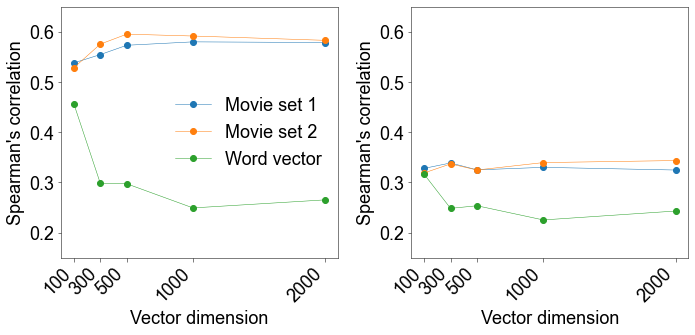

In [55]:
ymin = 0.15
ymax = 0.65

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2", "Word vector"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = br_coefs[0]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[0]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.legend(grp_labels, loc="right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = br_coefs[1]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[1]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_all_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

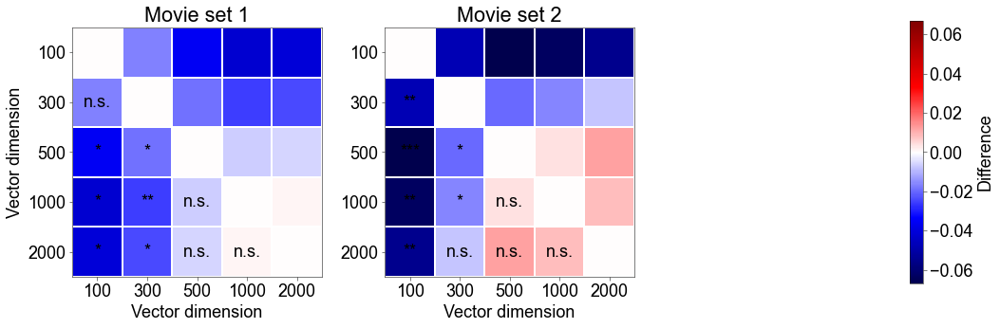

In [56]:
# Comparison across vector dimmensions

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

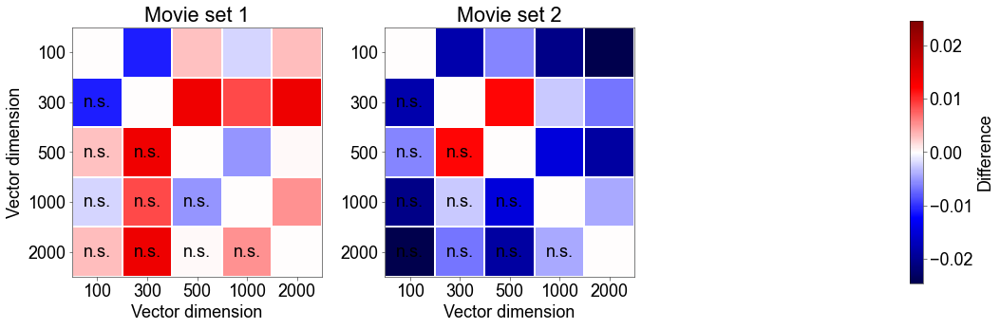

In [57]:
# Adjective
pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. S17: Behavioral correlation for all vector dimensions of GloVe

In [58]:
model_idx = 1
model = model_names[model_idx]

# Correlation with behavior

n_vecsizes = mov1_noun_dissim[model_idx].shape[0]

br_coefs = np.zeros((2, 2, n_vecsizes))  # POS x movie set x dimension
br_pvals = np.ones((2, 2, n_vecsizes))

wv_coefs = np.zeros((2, n_vecsizes))  # POS x dimension
wv_pvals = np.zeros((2, n_vecsizes))

n_word_pairs = int(n_nouns * (n_nouns - 1) / 2)

behav_mean_dissim = np.zeros((2, n_word_pairs))
brain_mean_dissim = np.zeros((2, 2, n_vecsizes, n_word_pairs))
wv_mean_dissim = np.zeros((2, n_vecsizes, n_word_pairs))

for posi, pos in enumerate(["noun", "adj"]):
    
    behav_mean_dissim[posi] = eval("behav_" + pos + "_dissim").mean(axis=0)
    
    wv_mean_dissim[posi] = eval("wv_" + pos + "_dissim")[model_idx]
    for vi in range(n_vecsizes):
        wv_coefs[posi, vi] = stats.spearmanr(wv_mean_dissim[posi, vi], behav_mean_dissim[posi])[0]
        
        samps = eval(f"wv_{pos}_corr_perm_samps")[model_idx, vi]
        p = np.sum(samps > wv_coefs[posi, vi]) / len(samps)
        if p > 0.5:
            p = 1 - p
        wv_pvals[posi, vi] = p
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        for vi in range(n_vecsizes):
            brain_mean_dissim[posi, movi, vi] = eval(mov + "_" + pos + "_dissim")[model_idx, vi]
            br_coefs[posi, movi, vi] = stats.spearmanr(brain_mean_dissim[posi, movi, vi], behav_mean_dissim[posi])[0]
            
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx, vi]
            p = np.sum(samps > br_coefs[posi, movi, vi]) / len(samps)
            if p > 0.5:
                p = 1 - p
            br_pvals[posi, movi, vi] = p

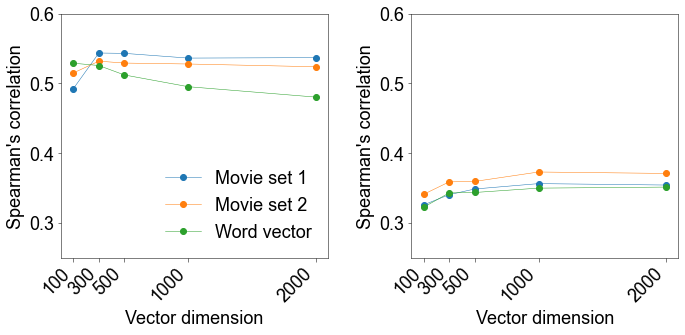

In [59]:
ymin = 0.25
ymax = 0.6

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2", "Word vector"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = br_coefs[0]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[0]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = br_coefs[1]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[1]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_all_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

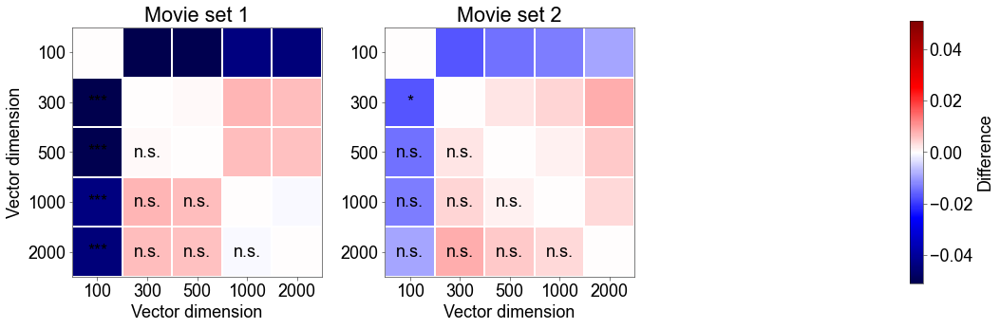

In [60]:
# Comparison across vector dimmensions

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

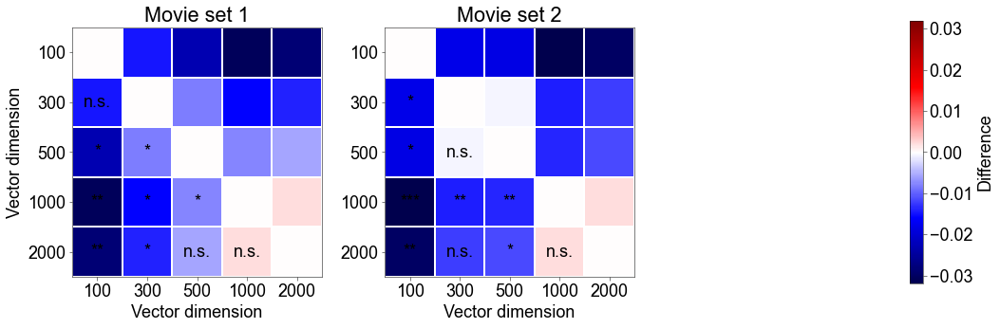

In [61]:
# Adjective
pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. S18: Behavioral correlation for all vector dimensions of word2vec

In [62]:
model_idx = 2
model = model_names[model_idx]

# Correlation with behavior

n_vecsizes = mov1_noun_dissim[model_idx].shape[0]

br_coefs = np.zeros((2, 2, n_vecsizes))  # POS x movie set x dimension
br_pvals = np.ones((2, 2, n_vecsizes))

wv_coefs = np.zeros((2, n_vecsizes))  # POS x dimension
wv_pvals = np.zeros((2, n_vecsizes))

n_word_pairs = int(n_nouns * (n_nouns - 1) / 2)

behav_mean_dissim = np.zeros((2, n_word_pairs))
brain_mean_dissim = np.zeros((2, 2, n_vecsizes, n_word_pairs))
wv_mean_dissim = np.zeros((2, n_vecsizes, n_word_pairs))

for posi, pos in enumerate(["noun", "adj"]):
    
    behav_mean_dissim[posi] = eval("behav_" + pos + "_dissim").mean(axis=0)
    
    wv_mean_dissim[posi] = eval("wv_" + pos + "_dissim")[model_idx]
    for vi in range(n_vecsizes):
        wv_coefs[posi, vi] = stats.spearmanr(wv_mean_dissim[posi, vi], behav_mean_dissim[posi])[0]
        
        samps = eval(f"wv_{pos}_corr_perm_samps")[model_idx, vi]
        p = np.sum(samps > wv_coefs[posi, vi]) / len(samps)
        if p > 0.5:
            p = 1 - p
        wv_pvals[posi, vi] = p
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        for vi in range(n_vecsizes):
            brain_mean_dissim[posi, movi, vi] = eval(mov + "_" + pos + "_dissim")[model_idx, vi]
            br_coefs[posi, movi, vi] = stats.spearmanr(brain_mean_dissim[posi, movi, vi], behav_mean_dissim[posi])[0]
            
            samps = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx, vi]
            p = np.sum(samps > br_coefs[posi, movi, vi]) / len(samps)
            if p > 0.5:
                p = 1 - p
            br_pvals[posi, movi, vi] = p

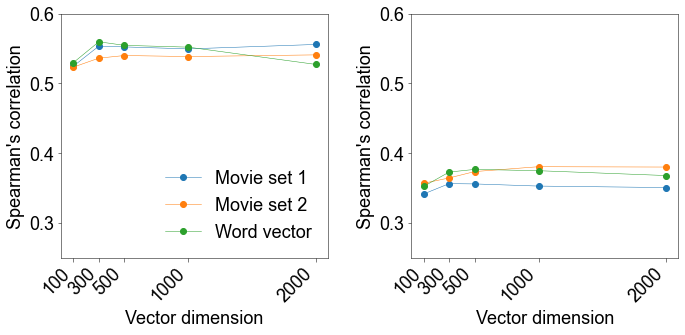

In [63]:
ymin = 0.25
ymax = 0.6

xlabels = vecsizes
grp_labels = ["Movie set 1", "Movie set 2", "Word vector"]

fig = plt.figure(figsize=(10, 5))

ax = plt.subplot(1, 2, 1)

x = vecsizes
y = br_coefs[0]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[0]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.legend(grp_labels, loc="lower right", frameon=False)

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

##

ax = plt.subplot(1, 2, 2)

x = vecsizes
y = br_coefs[1]
for i in range(2):
    ax.plot(x, y[i, :], marker="o", c=mpl.cm.tab10(i))

y = wv_coefs[1]
ax.plot(x, y, marker="o", c=mpl.cm.tab10(2))

ax.set_xlabel("Vector dimension")
ax.set_xticks(x)
ax.set_xticklabels(xlabels, rotation=45, ha="right")
ax.set_ylim([ymin, ymax])
ax.set_ylabel("Spearman's correlation")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_all_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

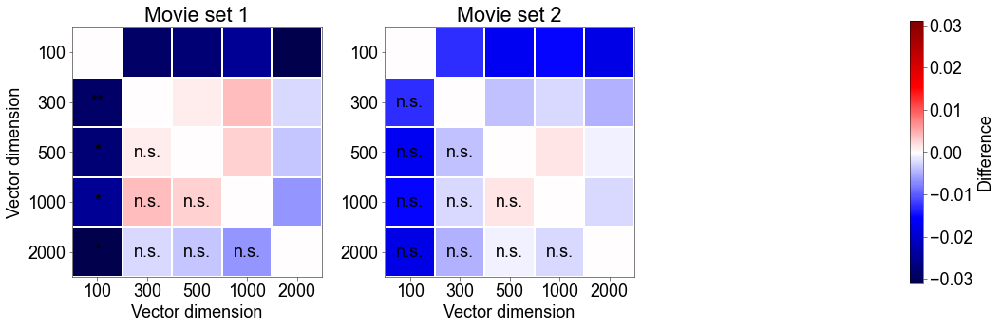

In [64]:
# Comparison across vector dimmensions

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

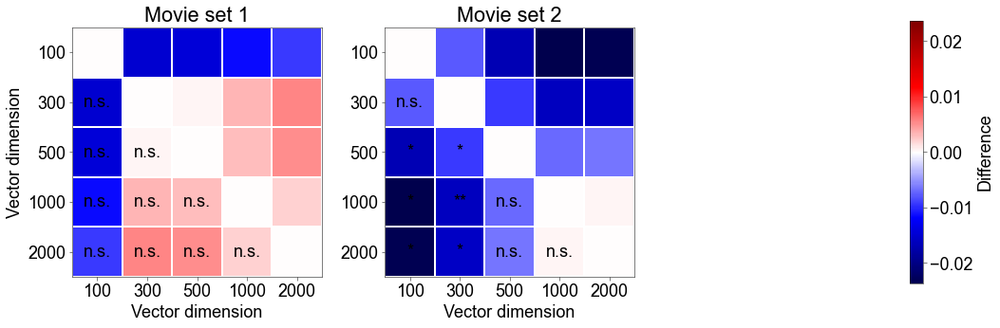

In [65]:
# Adjective
pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_vecsizes), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))

for movi, mov in enumerate(["mov1", "mov2"]):
    
    for i, p in enumerate(pairs):
        diff_vals[movi, i] = br_coefs[posi, movi, p[0]] - br_coefs[posi, movi, p[1]]
        
        tmp = eval(f"{mov}_{pos}_corr_perm_samps")[model_idx]
        samps = tmp[p[0]] - tmp[p[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p

# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

##

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_vecsizes) + .5)
    ax.set_xticklabels(vecsizes)
    ax.set_xlabel("Vector dimension")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_vecsizes) + .5)
    ax.set_yticklabels(vecsizes)
    if i == 0:
        ax.set_ylabel("Vector dimension")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. S19: Brain-behavior correlation of word dissimilarity for the same participant pool

In [66]:
for pos in ["noun", "adj"]:
    exec(f"overlap_behav_{pos}_dissim = behav_{pos}_dissim[mri_subj_names != '']")
    exec(f"overlap_behav_{pos}_mean_dissim = stats.zscore(overlap_behav_{pos}_dissim.mean(axis=0))")
    exec(f"overlap_brain_{pos}_mean_dissim = stats.zscore(overlap_brain_{pos}_dissim.mean(axis=1), axis=1)")

### Dissimilarity matrix

Model: fastText
Dimension = 1000
Noun


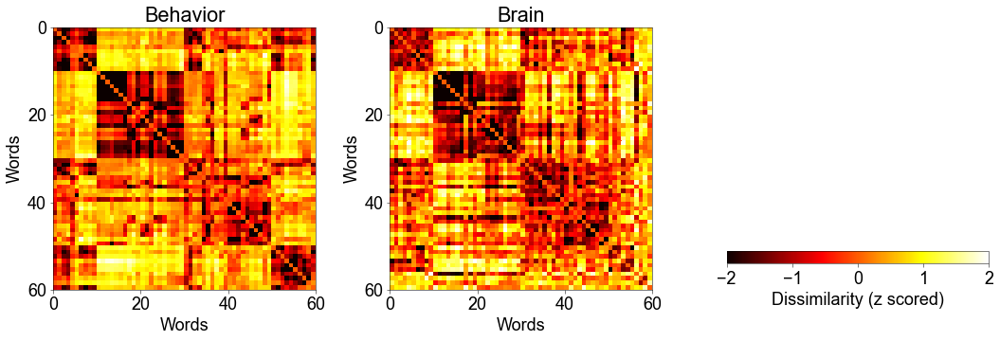

Adjective


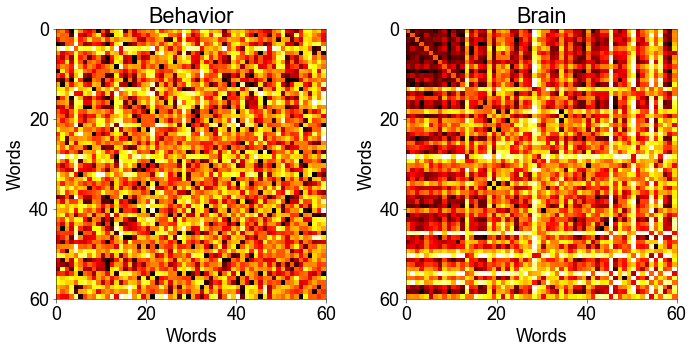

In [67]:
model_idx = 0

print("Model: " + model_full_names[model_idx])
print("Dimension = {}".format(overlap_vecsize))

titles = ["Behavior", "Brain"]

min_val = -2
max_val = 2

# Noun

print("Noun")

fig = plt.figure(figsize=(15, 5))

for i, (dissim, t) in enumerate(zip([overlap_behav_noun_mean_dissim, overlap_brain_noun_mean_dissim[model_idx]], titles)):
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(dissim), vmin=min_val, vmax=max_val, cmap="hot")
    ax.axis("square")

    ax.set_xlabel("Words")
    ax.set_xticks(np.linspace(0, 60, 4))
    ax.invert_yaxis()
    ax.set_ylabel("Words")
    ax.set_yticks(np.linspace(0, 60, 4))
    ax.set_title(t)

# Colorbar
ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

m = ax.pcolor(X, Y, Z, cmap="hot", vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(m, ax=ax, orientation="horizontal")
cbar.set_label("Dissimilarity (z scored)")

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_mat_mrisubj_noun.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

##
# Adjective

print("Adjective")

fig = plt.figure(figsize=(10, 5))

for i, (dissim, t) in enumerate(zip([overlap_behav_adj_mean_dissim, overlap_brain_adj_mean_dissim[model_idx]], titles)):
    ax = plt.subplot(1, 2, i + 1)
    ax.pcolor(distance.squareform(dissim), vmin=min_val, vmax=max_val, cmap="hot")
    ax.axis("square")

    ax.set_xlabel("Words")
    ax.set_xticks(np.linspace(0, 60, 4))
    ax.invert_yaxis()
    ax.set_ylabel("Words")
    ax.set_yticks(np.linspace(0, 60, 4))
    ax.set_title(t)

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_mat_mrisubj_adj.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

### Correlation

In [68]:
print("Dimension = {}".format(overlap_vecsize))

print("Noun:")

coef = stats.spearmanr(overlap_behav_noun_mean_dissim, overlap_brain_noun_mean_dissim[model_idx])[0]
samps = overlap_noun_corr_perm_samps[model_idx]
pval = np.sum(samps > coef) / len(samps)
print(" Behav & Brain: rho = {}, p = {}".format(coef, pval))

print("Adjective:")

coef = stats.spearmanr(overlap_behav_adj_mean_dissim, overlap_brain_adj_mean_dissim[model_idx])[0]
samps = overlap_adj_corr_perm_samps[model_idx]
pval = np.sum(samps > coef) / len(samps)
print(" Behav & Brain: rho = {}, p = {}".format(coef, pval))

Dimension = 1000
Noun:
 Behav & Brain: rho = 0.5371137711781228, p = 0.0
Adjective:
 Behav & Brain: rho = 0.22615744627839443, p = 0.0


### All models

In [69]:
br_rvals = np.zeros((2, n_models))  # POS x model
br_pvals = np.zeros((2, n_models))

for posi, pos in enumerate(["noun", "adj"]):
    for mi, model in enumerate(model_names):
        br_rvals[posi, mi] = stats.spearmanr(eval(f"overlap_behav_{pos}_mean_dissim"), eval(f"overlap_brain_{pos}_mean_dissim")[mi])[0]
        
        samps = eval(f"overlap_{pos}_corr_perm_samps")[mi]
        p = np.sum(samps > br_rvals[posi, mi]) / len(samps)
        if p > 0.5:
            p = 1 - p
        br_pvals[posi, mi] = p

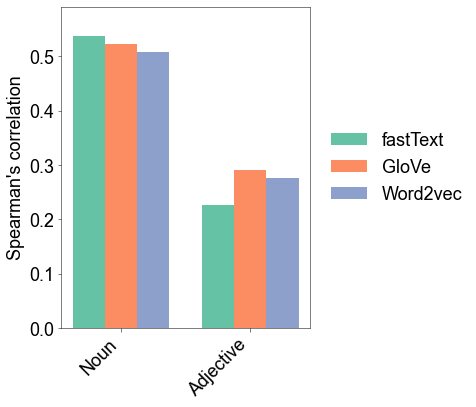

In [70]:
x = np.arange(2)
width = 0.25

y_max = br_rvals.ravel().max() * 1.1

fig = plt.figure(figsize=[7, 6])
ax = plt.subplot(1, 1, 1)

for posi, pos in enumerate(["noun", "adjectives"]):
    
    for mi in range(n_models):
        r = br_rvals[posi, mi]
        ax.bar(x[posi] + width * (mi - 1), r, width=width, fc=mpl.cm.Set2(mi))
        
ax.legend(handles, model_full_names, bbox_to_anchor=(1.02, 0.5), loc="center left", frameon=False)
    
ax.set_xticks(x)
ax.set_xticklabels(["Noun", "Adjective"], rotation=45, ha="right")
ax.set_ylabel("Spearman's correlation")
ax.set_ylim([0, y_max])
    
fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr_mrisubj.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

In [71]:
corr_pvals = fdrcorrection(br_pvals.ravel(), alpha=thresh_alpha)[1].reshape(br_pvals.shape)

print("Dimension = {}".format(overlap_vecsize))

print("Noun:")

for mi, model in enumerate(model_full_names):
    print(" {}: rho = {}, p = {}".format(model, br_rvals[0, mi], corr_pvals[0, mi]))

print("Adjective:")

for mi, model in enumerate(model_full_names):
    print(" {}: rho = {}, p = {}".format(model, br_rvals[1, mi], corr_pvals[1, mi]))

Dimension = 1000
Noun:
 fastText: rho = 0.5371137711781228, p = 0.0
 GloVe: rho = 0.5217622086428306, p = 0.0
 Word2vec: rho = 0.5070542174667801, p = 0.0
Adjective:
 fastText: rho = 0.22615744627839443, p = 0.0
 GloVe: rho = 0.2906854771500665, p = 0.0
 Word2vec: rho = 0.27697959459122506, p = 0.0


## Fig. S20: Brain-behavior correlation of word dissimilarity at the individual level

In [72]:
rvals = np.zeros((2, n_models, n_overlap))
pvals = np.ones((2, n_models, n_overlap))

for posi, pos in enumerate(["noun", "adj"]):
    for mi, model in enumerate(model_names):
        for i, name in enumerate(mri_subj_names[mri_subj_names != ""]):
            rvals[posi, mi, i] = stats.spearmanr(eval(f"overlap_brain_{pos}_dissim")[mi, i], eval(f"overlap_behav_{pos}_dissim")[i])[0]
            
            samps = eval(f"overlap_{pos}_indiv_corr_perm_samps")[mi, i]
            p = np.sum(samps > rvals[posi, mi, i]) / len(samps)
            if p > 0.5:
                p = 1 - p
            pvals[posi, mi, i] = p

corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

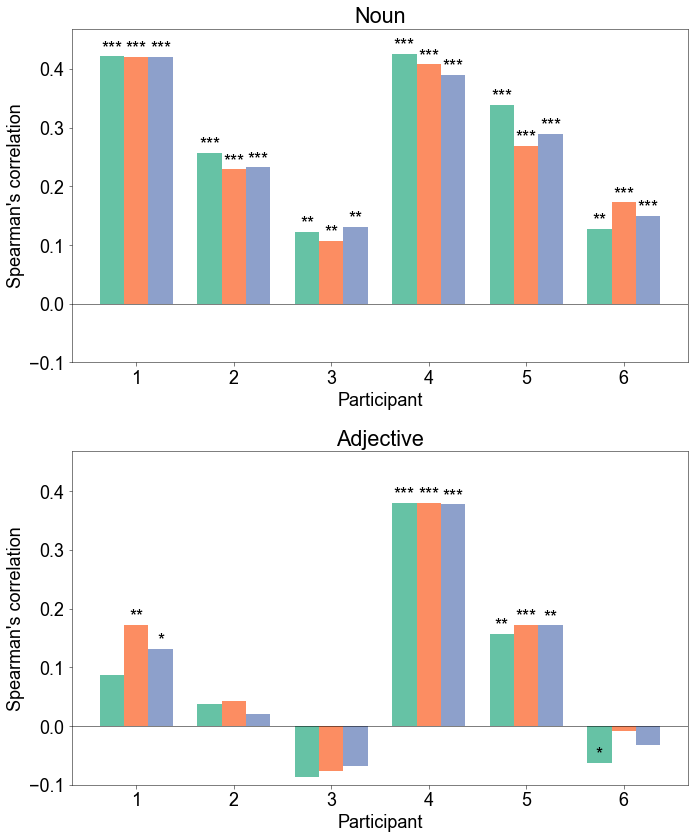

In [73]:
title_labs = ["Noun", "Adjective"]
x = np.arange(n_overlap)
width = 0.25

y_max = rvals.ravel().max() * 1.1
y_min = -0.1

fig = plt.figure(figsize=[10, 12])

for posi, pos in enumerate(["noun", "adj"]):
    
    ax = plt.subplot(2, 1, posi + 1)
    
    handles = []
    for mi in range(n_models):
        r = rvals[posi, mi]
        ax.bar(x + width * (mi - 1), r, width=width, fc=mpl.cm.Set2(mi))
        
        for i, p in enumerate(corr_pvals[posi, mi]):
            if p < 0.0001:
                mk = "***"
            elif p < 0.01:
                mk = "**"
            elif p < 0.05:
                mk = "*"
            else:
                mk = ""
            
            ax.text(x[i] + width * (mi - 1), r[i] + 0.005, mk, ha="center")
        
    ax.set_xticks(x)
    ax.set_xticklabels(x + 1)
    ax.set_xlabel("Participant")
    ax.set_ylabel("Spearman's correlation")
    ax.set_ylim([y_min, y_max])
    ax.axhline(0, c="k")
    ax.set_title(title_labs[posi])

fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr_each_mrisubj.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Figs. 8 and S21-23: Effects of voxel selection on dissimilarity correlation

In [74]:
coefs = np.zeros((2, n_models, 2, n_n_sel_voxels + 1))  # POS x movdel x movie set x voxel selection
pvals = np.ones((2, n_models, 2, n_n_sel_voxels + 1))
perm_samps = np.zeros((2, n_models, 2, n_n_sel_voxels + 1, n_perm_itrs))

for posi, pos in enumerate(["noun", "adj"]):
    for mi, model in enumerate(model_names):
        for movi, mov in enumerate(["mov1", "mov2"]):
            for i in range(n_n_sel_voxels):
                coefs[posi, mi, movi, i], pvals[posi, mi, movi, i] = stats.spearmanr(eval(f"{mov}_{pos}_dissim_selvox")[mi, i], eval(f"behav_{pos}_mean_dissim"))
            coefs[posi, mi, movi, n_n_sel_voxels], pvals[posi, mi, movi, n_n_sel_voxels] = stats.spearmanr(eval(f"{mov}_{pos}_dissim")[mi, dim_idx], eval(f"behav_{pos}_mean_dissim"))
            
            perm_samps[posi, mi, movi, :-1] = eval(f"{mov}_{pos}_corr_perm_samps_selvox")[mi]
            perm_samps[posi, mi, movi, -1] = eval(f"{mov}_{pos}_corr_perm_samps")[mi, dim_idx]

### Function of correlation coefficients against the number of selected voxels

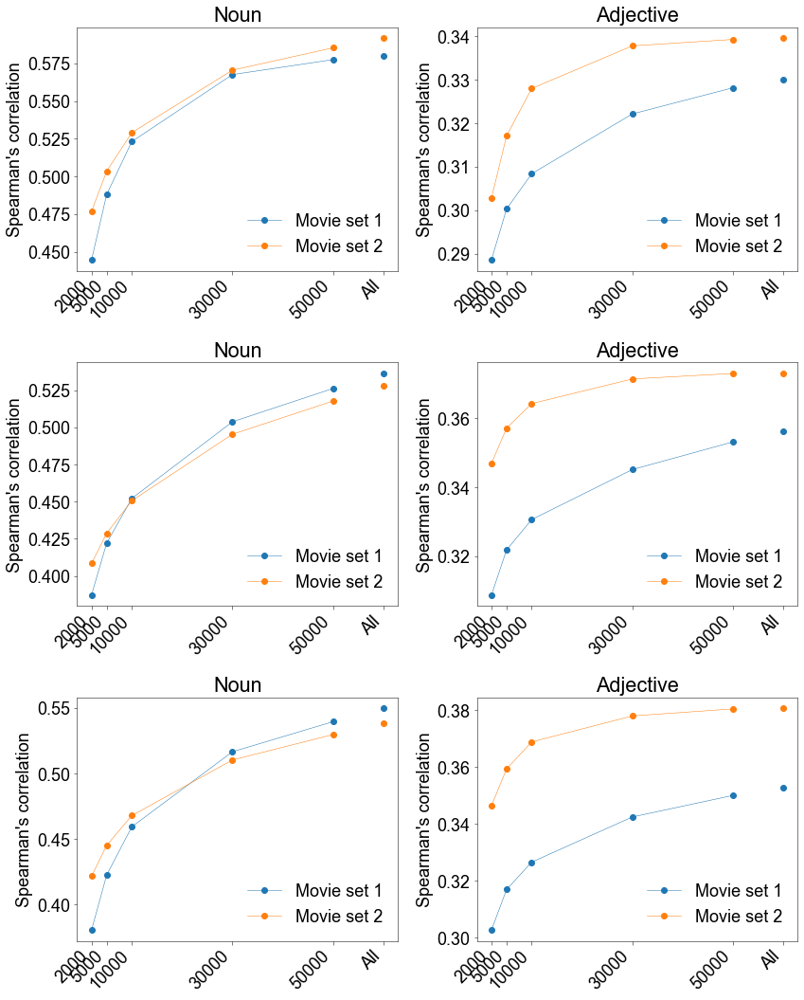

In [75]:
# Nouns

xlabels = np.append(n_sel_voxels, "All")
n_xlabels = len(xlabels)

grp_labels = ["Movie set 1", "Movie set 2"]

fig = plt.figure(figsize=(12, 15))

for mi, model in enumerate(model_full_names):
    
    ax = plt.subplot(3, 2, mi * 2 + 1)

    x = np.hstack([n_sel_voxels, n_sel_voxels[-1] * 1.2])
    y = coefs[0, mi]
    for i in range(2):
        ax.plot(x[:-1], y[i, :-1], marker="o", c=mpl.cm.tab10(i))
        ax.plot(x[-1], y[i, -1], marker="o", c=mpl.cm.tab10(i), label="_nolegend_")

    ax.legend(grp_labels, loc="lower right", frameon=False)

    ax.set_xticks(x)
    ax.set_xticklabels(xlabels, rotation=45, ha="right")
    ax.set_ylabel("Spearman's correlation")
    ax.set_title("Noun")

    ##
    # Adjectives

    ax = plt.subplot(3, 2, mi * 2 + 2)

    x = np.hstack([n_sel_voxels, n_sel_voxels[-1] * 1.2])
    y = coefs[1, mi]
    for i in range(2):
        ax.plot(x[:-1], y[i, :-1], marker="o", c=mpl.cm.tab10(i))
        ax.plot(x[-1], y[i, -1], marker="o", c=mpl.cm.tab10(i), label="_nolegend_")

    ax.legend(grp_labels, loc="lower right", frameon=False)

    ax.set_xticks(x)
    ax.set_xticklabels(xlabels, rotation=45, ha="right")
    ax.set_ylabel("Spearman's correlation")
    ax.set_title("Adjective")

##

plt.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr_selvox.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Comparison across voxel selections for fastText

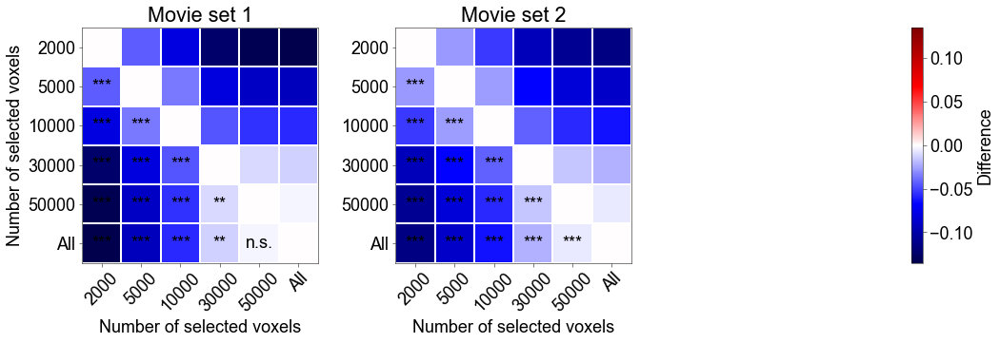

In [76]:
model_idx = 0
model = model_names[model_idx]

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

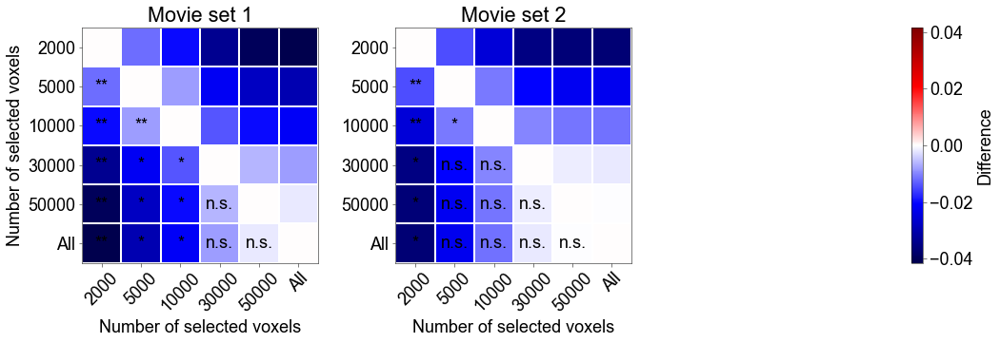

In [77]:
# Adjective

pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

### Comparison across voxel selections for GloVe

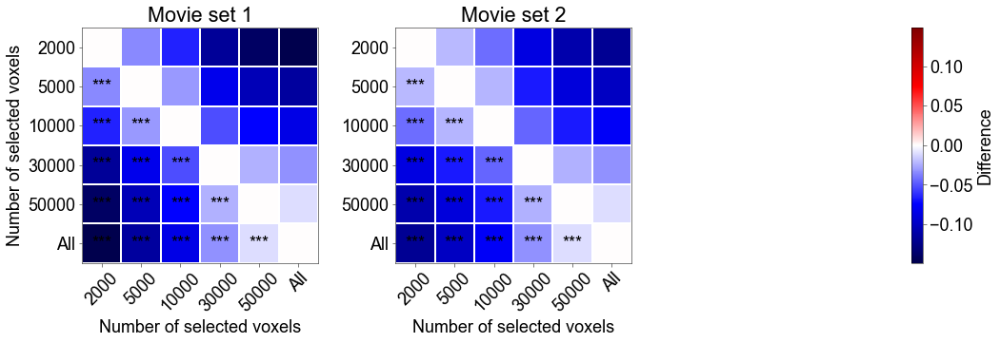

In [78]:
model_idx = 1
model = model_names[model_idx]

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

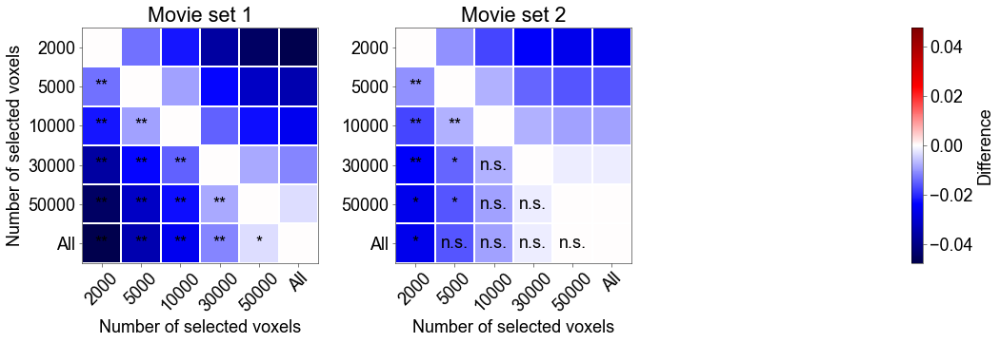

In [79]:
# Adjective

pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

### Comparison across voxel selections for word2vec

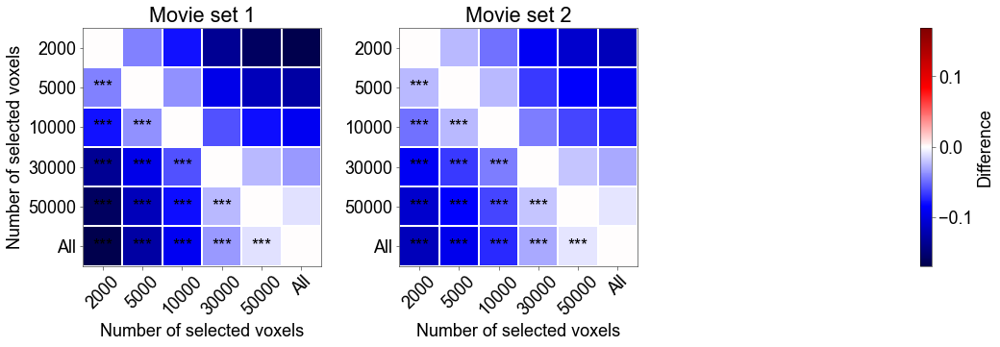

In [80]:
model_idx = 2
model = model_names[model_idx]

# Noun
pos = "noun"
posi = 0

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_noun_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

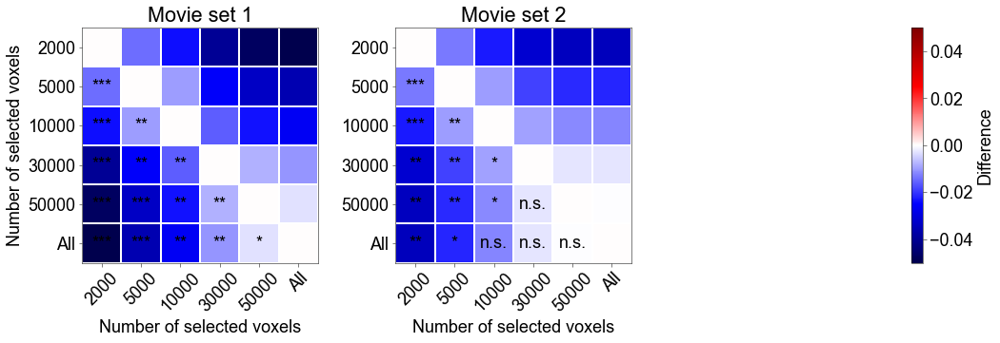

In [81]:
# Adjective

pos = "adj"
posi = 1

pairs = list(itertools.combinations(range(n_xlabels), 2))
n_pairs = len(pairs)

diff_vals = np.zeros((2, n_pairs))
pvals = np.zeros((2, n_pairs))
for movi, mov in enumerate(["mov1", "mov2"]):
    for i, ps in enumerate(pairs):
        diff_vals[movi, i] = coefs[posi, model_idx, movi, ps[0]] - coefs[posi, model_idx, movi, ps[1]]
        
        tmp = perm_samps[posi, model_idx, movi]
        samps = tmp[ps[0]] - tmp[ps[1]]
        p = np.sum(samps > diff_vals[movi, i]) / len(samps)
        if p > 0.5:
            p = 1 - p
        pvals[movi, i] = p
    
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

max_val = np.max([np.abs(np.max(diff_vals)), np.abs(np.min(diff_vals))])
min_val = -max_val

##
# Plot
cm = "seismic"
mk_col = "k"

fig = plt.figure(figsize=(15, 5))

for i, (vals, ps) in enumerate(zip(diff_vals, corr_pvals)):
    
    ax = plt.subplot(1, 3, i + 1)
    ax.pcolor(distance.squareform(vals), vmin=min_val, vmax=max_val, cmap=cm, ec="w", lw=1)
    ax.axis("square")
    
    for j, p in enumerate(pairs):
        mk = ""
        if ps[j] < 0.0001:
            mk = "***"
        elif ps[j] < 0.01:
            mk = "**"
        elif ps[j] < 0.05:
            mk = "*"
        elif ps[j] > 0.05:
            mk = "n.s."
        
        if mk != "":
            ax.text(p[0] + .5, p[1] + .5, mk, c=mk_col, ha="center", va="center")
    
    ax.set_xticks(np.arange(n_xlabels) + .5)
    ax.set_xticklabels(xlabels, rotation=45)
    ax.set_xlabel("Number of selected voxels")
    
    ax.invert_yaxis()
    ax.set_yticks(np.arange(n_xlabels) + .5)
    ax.set_yticklabels(xlabels)
    if i == 0:
        ax.set_ylabel("Number of selected voxels")
        
    if i == 0:
        ax.set_title("Movie set 1")
    elif i == 1:
        ax.set_title("Movie set 2")

# Colorbar

ax = plt.subplot(1, 3, 3)

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="vertical")
cbar.set_label("Difference")

plt.tight_layout()
plt.show()

##

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, 'dissim_corr_cmpr_selvox_adj_ft.pdf'))
pp.savefig(fig, dpi=300, bbox_inches='tight')
pp.close()

## Fig. 9-10 and Table S15-16: Cortical mapping of brain-behavior correlations

In [82]:
for pos in ["noun", "adj"]:
    behav_mean_dissim = eval(f"behav_{pos}_dissim").mean(axis=0)
    
    # Variable initialization
    exec(f"{pos}_rvals = np.zeros((n_models, 2, n_rois))")
    exec(f"{pos}_pvals = np.ones((n_models, 2, n_rois))")
    
    for mi, model in enumerate(model_names):
        for movi, mov in enumerate(["mov1", "mov2"]):
            for ri, roi in enumerate(roi_names):
                if np.all(eval(mov + "_roi_n_voxels")[ri] != 0):
                    eval(f"{pos}_rvals")[mi, movi, ri], eval(f"{pos}_pvals")[mi, movi, ri] = stats.spearmanr(eval(f"{mov}_roi_{pos}_dissim")[mi, ri], behav_mean_dissim)
                
    exec(f"{pos}_corr_pvals = np.reshape(fdrcorrection({pos}_pvals.ravel(), alpha=thresh_alpha)[1], {pos}_pvals.shape)")

### Nouns

ftsg
mov1


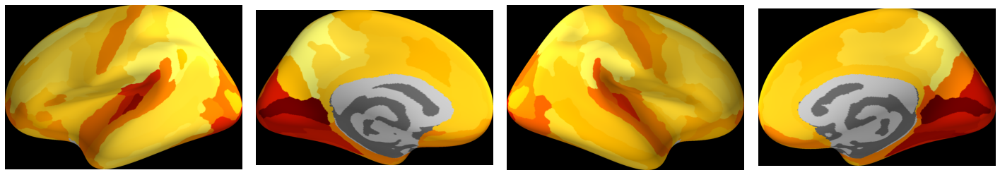

mov2


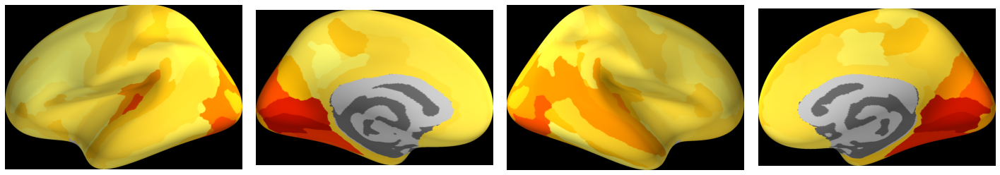

glove
mov1


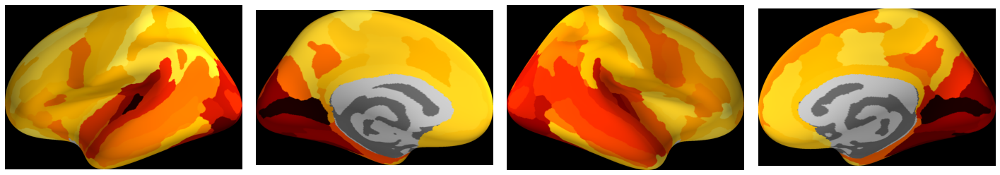

mov2


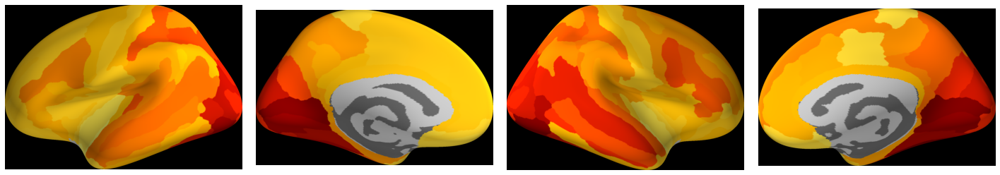

w2vsg
mov1


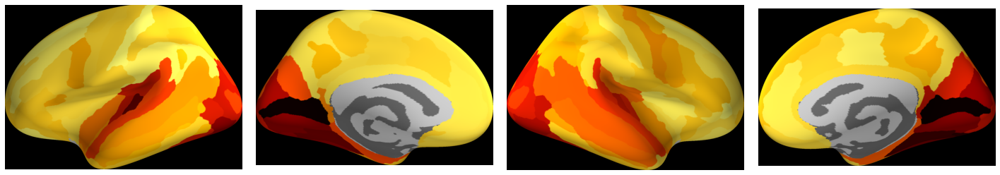

mov2


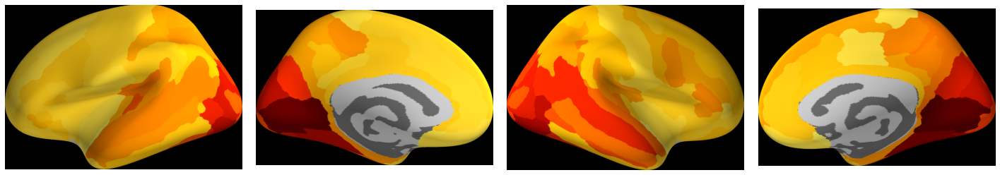

In [84]:
out_prefix = os.path.join(out_dir, "dissim_corr_noun_map")

# Min and max values
min_val = np.min(noun_rvals[noun_rvals != 0])
max_val = np.max(noun_rvals[noun_rvals != 0])

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for mi, model in enumerate(model_names):
    print(model)
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print(mov)
        
        out_base = "{}_{}_{}".format(out_prefix, model, mov)

        # Get values for each ROI
        vals = noun_rvals[mi, movi]
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Colorbar

Value range: 0.3557919206914659 - 0.6211863792738541


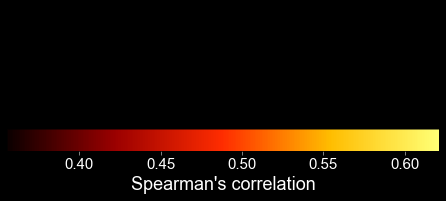

In [85]:
out_name = out_prefix + "_colbar.pdf"

print("Value range: {} - {}".format(min_val, max_val))

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

fig = plt.figure(facecolor="k")
ax = fig.add_axes((0, 0, 1, 1/3))

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="horizontal")
cbar.set_label("Spearman's correlation", color="w")
cbar.ax.spines["bottom"].set_color("w")
cbar.ax.spines["top"].set_color("w")
cbar.ax.spines["left"].set_color("w")
cbar.ax.spines["right"].set_color("w")
cbar.ax.xaxis.label.set_color("w")
cbar.ax.yaxis.label.set_color("w")
cbar.ax.tick_params(axis="x", colors="w", labelsize=15)
cbar.ax.tick_params(axis="y", colors="w")

pp = PdfPages(out_name)
pp.savefig(fig, dpi=300, bbox_inches="tight", facecolor="black")
pp.close()

### Adjectives

ftsg
mov1


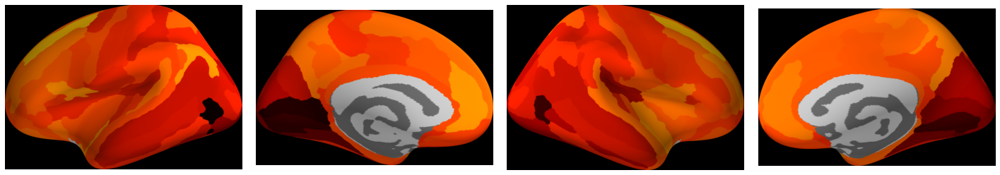

mov2


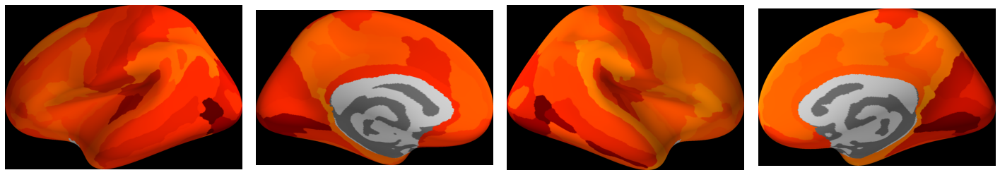

glove
mov1


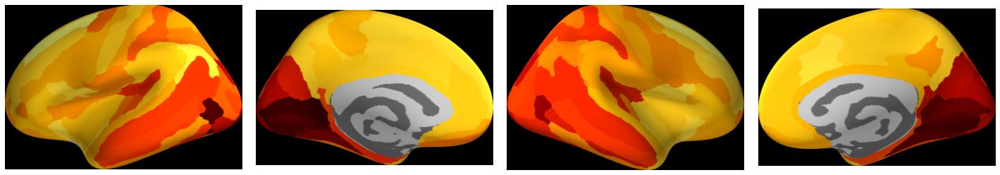

mov2


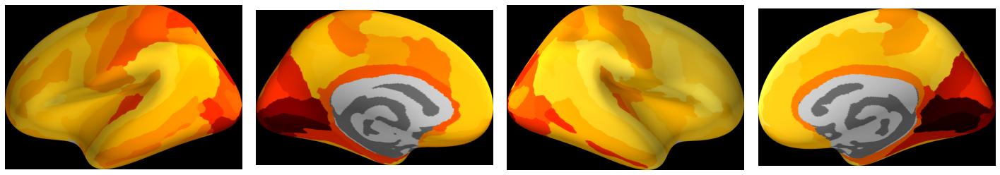

w2vsg
mov1


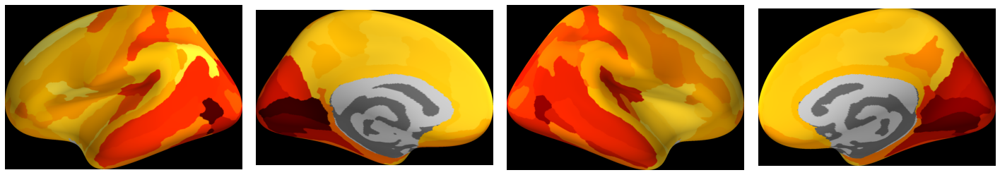

mov2


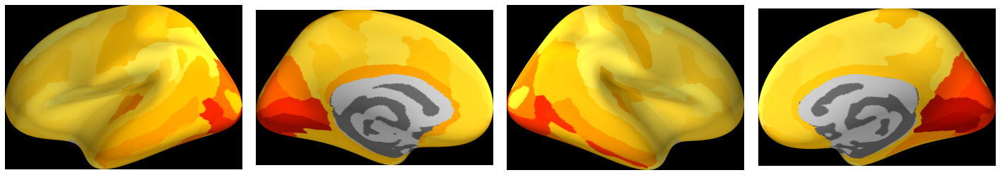

In [87]:
out_prefix = os.path.join(out_dir, "dissim_corr_adjective_map")

# Min and max values
min_val = np.min(adj_rvals[adj_rvals != 0])
max_val = np.max(adj_rvals[adj_rvals != 0])

thresh_val = min_val
null_val = -1
cm = generate_cmap(mpl.cm.hot([0, 55, 110, 165, 220]))
alpha = 1

for mi, model in enumerate(model_names):
    print(model)
    
    for movi, mov in enumerate(["mov1", "mov2"]):
        print(mov)
        
        out_base = "{}_{}_{}".format(out_prefix, model, mov)

        # Get values for each ROI
        vals = adj_rvals[mi, movi]
        hemi_vals = np.zeros((2, n_hemi_rois)) - 1  # hemisphere x ROI
        for i in range(2):
            mask = roi_idx[i, :] != -1
            hemi_vals[i, mask] = vals[roi_idx[i, mask]]

        views = ["lat", "med"]

        plt.figure(figsize=(20, 5))
        j = 1
        
        for i, (hemi, labels) in enumerate(zip(["lh", "rh"], [lh_labels, rh_labels])):
            
            # Bring up the visualization.
            brain = Brain(subject_id, hemi, surf, background="black", subjects_dir=subjects_dir, size=1600)

            vtx_data = hemi_vals[i, labels]
            vtx_data[labels == -1] = null_val
            brain.add_data(vtx_data, min_val, max_val, thresh=thresh_val, colormap=cm, alpha=alpha,
                           colorbar=False, smoothing_steps=None, verbose=0)

            ## Save views
            for view in views:
                brain.show_view(view)
                fname = "{}_{}_{}.png".format(out_base, hemi, view)
                brain.save_image(fname)

                ## Trim
                cmd = 'mogrify -trim ' + fname
                subprocess.call(cmd.split())
                
            brain.close()

            ### Show images
            for view in views:
                img = np.array(Image.open("{}_{}_{}.png".format(out_base, hemi, view)))
                plt.subplot(1, 4, j)
                plt.imshow(img)
                plt.axis("off")
                j += 1

        plt.tight_layout()
        plt.show()

### Colorbar

Value range: 0.24624966594945766 - 0.400273200149311


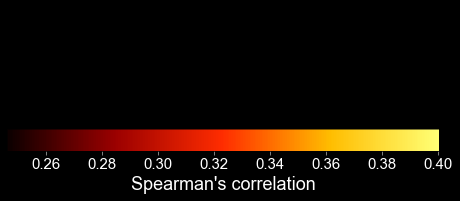

In [88]:
out_name = out_prefix + "_colbar.pdf"

print("Value range: {} - {}".format(min_val, max_val))

x = np.arange(0, 1)
y = np.arange(0, 1)
X, Y = np.meshgrid(x, y)
Z = np.arange(len(x) * len(y)).reshape(len(y), -1)

fig = plt.figure(facecolor="k")
ax = fig.add_axes((0, 0, 1, 1/3))

mappable = ax.pcolor(X, Y, Z, cmap=cm, vmin=min_val, vmax=max_val)
ax.set_axis_off()

cbar = fig.colorbar(mappable, ax=ax, orientation="horizontal")
cbar.set_label("Spearman's correlation", color="w")
cbar.ax.spines["bottom"].set_color("w")
cbar.ax.spines["top"].set_color("w")
cbar.ax.spines["left"].set_color("w")
cbar.ax.spines["right"].set_color("w")
cbar.ax.xaxis.label.set_color("w")
cbar.ax.yaxis.label.set_color("w")
cbar.ax.tick_params(axis="x", colors="w", labelsize=15)
cbar.ax.tick_params(axis="y", colors="w")

pp = PdfPages(out_name)
pp.savefig(fig, dpi=300, bbox_inches="tight", facecolor="black")
pp.close()

### Make tables of brain-behavior correlations

In [89]:
for pos in ["noun", "adj"]:
    for mi, model in enumerate(model_names):
        for movi, mov in enumerate(["mov1", "mov2"]):
            rvals = eval(pos + "_rvals")[mi, movi]
            pvals = eval(pos + "_pvals")[mi, movi]

            pd.DataFrame(np.hstack([roi_names[:, np.newaxis], rvals[:, np.newaxis], pvals[:, np.newaxis]]), columns=["ROI", "r", "p"]).to_csv(
                "{}/dissim_corr_roi_{}_{}_{}.csv".format(out_dir, pos, model, mov), index=False)

## Fig. S24: Behavioral correlates in each noun category

In [90]:
# Statistical test
pvals = np.ones((2, n_models, n_noun_cats))
for movi, mov in enumerate(["mov1", "mov2"]):
    for mi in range(n_models):
        for cati in range(n_noun_cats):
            val = eval(f"cat_{mov}_corr")[mi, cati]
            samps = eval(f"cat_{mov}_corr_perm_samps")[mi, cati]
            
            p = np.sum(samps > val) / len(samps)
            if p > 0.5:
                p = 1 - p
            pvals[movi, mi, cati] = p
            
# FDR correction
corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)

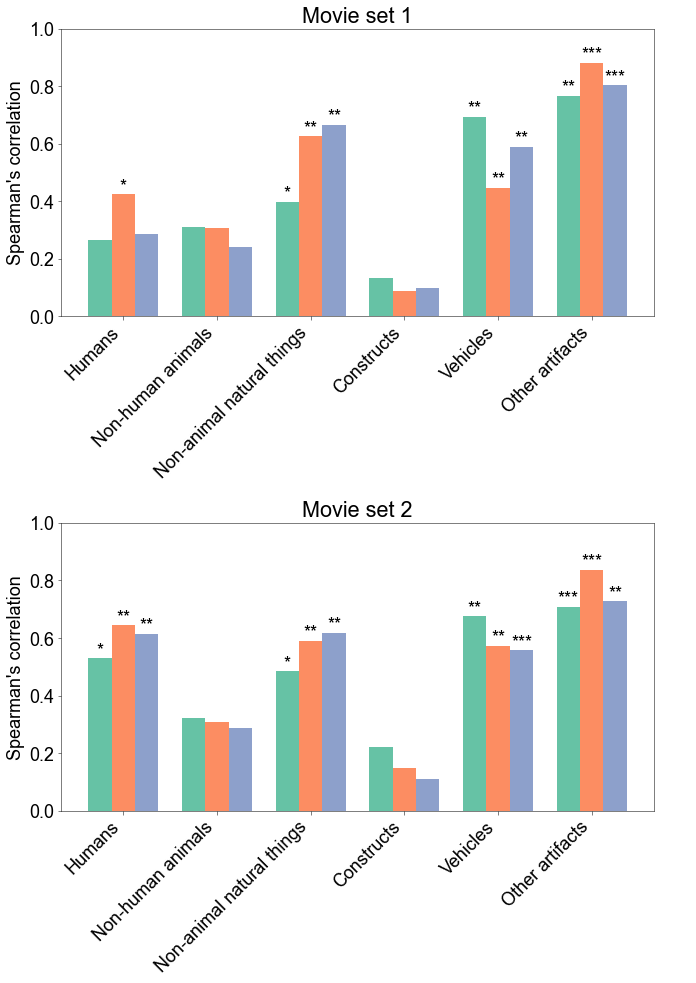

In [91]:
title_labs = ["Movie set 1", "Movie set 2"]
x = np.arange(n_noun_cats)
width = 0.25

y_range = [0, 1]

fig = plt.figure(figsize=[10, 14])

for movi, mov in enumerate(["mov1", "mov2"]):
    
    ax = plt.subplot(2, 1, movi + 1)
    
    for mi in range(n_models):
        y = eval(f"cat_{mov}_corr")[mi]
        h = ax.bar(x + width * (mi - 1), y, width=width, fc=mpl.cm.Set2(mi))
        
    if movi == 1:
        ax.legend(handles, model_full_names, bbox_to_anchor=(1.02, 0.5), loc="center left", frameon=False)
    
    for mi in range(n_models):
        for cati in range(n_noun_cats):
            p = corr_pvals[movi, mi, cati]
            if p < 0.0001:
                mk = "***"
            elif p < 0.01:
                mk = "**"
            elif p < 0.05:
                mk = "*"
            else:
                mk = ""
            ax.text(x[cati] + width * (mi - 1), eval(f"cat_{mov}_corr")[mi, cati]+ 0.01, mk, ha="center")
            
    ax.set_xticks(x)
    ax.set_xticklabels(noun_categories, rotation=45, ha="right")
    ax.set_ylabel("Spearman's correlation")
    ax.set_ylim(y_range)
    ax.set_title(title_labs[movi])

fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr_category.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

## Fig. S25: Dissimilarity correlation for binary-labeling model

In [92]:
pvals = np.ones((2, n_all_models, 2, n_bow_vecsizes))
diff_pvals = np.ones((2, n_models, 2, n_bow_vecsizes))

for posi, pos in enumerate(["Noun", "Adjective"]):
    for si, size in enumerate(bow_vecsizes):
        for movi, mov in enumerate(["Movie set 1", "Movie set 2"]):
            for mi in range(n_all_models):
                samps = bow_corr_perm_samps[posi, mi, movi, si]
                pvals[posi, mi, movi, si] = np.sum(samps > bow_corr[posi, mi, movi, si]) / len(samps)
                
            for mi in range(n_models):
                samps = bow_corr_perm_samps[posi, mi, movi, si] - bow_corr_perm_samps[posi, -1, movi, si]
                p = np.sum(samps > (bow_corr[posi, mi, movi, si] - bow_corr[posi, -1, movi, si])) / len(samps)
                if p > 0.5:
                    p = 1 - 0.5
                diff_pvals[posi, mi, movi, si] = p

corr_pvals = fdrcorrection(pvals.ravel(), alpha=thresh_alpha)[1].reshape(pvals.shape)
corr_diff_pvals = fdrcorrection(diff_pvals.ravel(), alpha=thresh_alpha)[1].reshape(diff_pvals.shape)

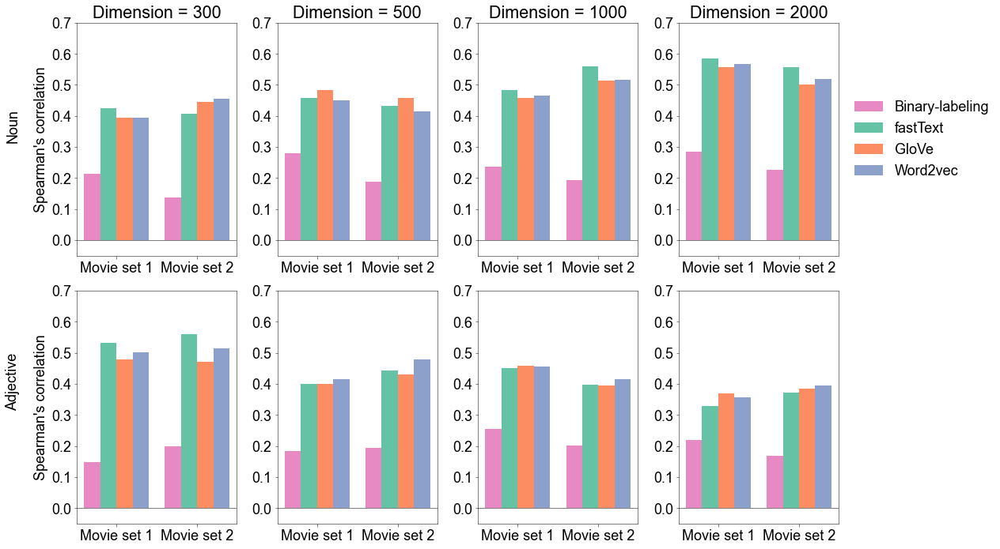

In [93]:
x = np.arange(2)
width = 0.2
y_min = -0.05
y_max = 0.7

row_labels = ["Noun", "Adjective"]

cols = mpl.cm.Set2(range(n_all_models))

fig = plt.figure(figsize=[18, 10])

for posi, pos in enumerate(["noun", "adj"]):
    for si, size in enumerate(bow_vecsizes):
    
        ax = plt.subplot(2, n_bow_vecsizes, posi * n_bow_vecsizes + si + 1)
        
        for i, mi in enumerate([3, 0, 1, 2]):
            r = bow_corr[posi, mi, :, si]
            ax.bar(x + width * (i - 1.5), r, width=width, fc=cols[mi])
        
        if posi == 0 and si == 3:
            ax.legend(["Binary-labeling"] + model_full_names, bbox_to_anchor=(1.02, 0.5), loc="center left", frameon=False)
            
        ax.axhline(0, c="k", label=None)
        
        if si == 0:
            ax.text(-0.4, 0.5, row_labels[posi], ha="center", rotation=90, transform=ax.transAxes)

        ax.set_xticks(x)
        ax.set_xticklabels(["Movie set 1", "Movie set 2"])
        if si == 0:
            ax.set_ylabel("Spearman's correlation")
        ax.set_ylim([y_min, y_max])
        if posi == 0:
            ax.set_title("Dimension = {}".format(size))

fig.tight_layout()
plt.show()

# Save the figure as a PDF file
pp = PdfPages(os.path.join(out_dir, "dissim_corr_bow.pdf"))
pp.savefig(fig, dpi=300, bbox_inches="tight")
pp.close()

### Statistics

In [94]:
for posi, pos in enumerate(["Noun", "Adjective"]):
    print(pos)
    
    for si, size in enumerate(bow_vecsizes):
        print(" Dimension = " + str(size))
        
        for movi, mov in enumerate(["Movie set 1", "Movie set 2"]):
            print("  " + mov)
            
            for mi, model in enumerate(model_full_names + ["Binary-labeling"]):
                print("   {}: p = {}".format(model, corr_pvals[posi, mi, movi, si]))
                
            for mi, model in enumerate(model_full_names):
                print("   Binary-labeling vs {}: p = {}".format(model, corr_diff_pvals[posi, mi, movi, si]))
                
        print("")

Noun
 Dimension = 300
  Movie set 1
   fastText: p = 0.006167272727272727
   GloVe: p = 0.007062068965517242
   Word2vec: p = 0.007918644067796611
   Binary-labeling: p = 0.05658412698412699
   Binary-labeling vs fastText: p = 0.1085
   Binary-labeling vs GloVe: p = 0.0648
   Binary-labeling vs Word2vec: p = 0.06852765957446809
  Movie set 2
   fastText: p = 0.00064
   GloVe: p = 0.0011076923076923076
   Word2vec: p = 0.0016592592592592592
   Binary-labeling: p = 0.1416
   Binary-labeling vs fastText: p = 0.050453333333333336
   Binary-labeling vs GloVe: p = 0.018763636363636364
   Binary-labeling vs Word2vec: p = 0.014971428571428571

 Dimension = 500
  Movie set 1
   fastText: p = 0.0001391304347826087
   GloVe: p = 0.0
   Word2vec: p = 0.0
   Binary-labeling: p = 0.001569811320754717
   Binary-labeling vs fastText: p = 0.015404651162790696
   Binary-labeling vs GloVe: p = 0.0012
   Binary-labeling vs Word2vec: p = 0.003938461538461538
  Movie set 2
   fastText: p = 0.000522448979591